In [1]:
import pandas as pd
import scanpy as sc
sc.set_figure_params(figsize=(8,8), fontsize=15, )
import numpy as np
from FACS_Sampling.preprocessing.utils import create_adata, read_tcell
from FACS_Sampling.methods.methods import sample_random, bin_sample, proportional_sampling, dist_sampling
from FACS_Sampling.plotting.plotting import change_cmap
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
adata = sc.read_h5ad("../../FACS_Sampling/datasets/healty_schayan.h5ad")

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/anndata/compat/__init__.py:232: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(


In [3]:
labels = pd.read_csv("../../FACS_Sampling/datasets/labels.csv")
from operator import methodcaller
labels_ = list(map(methodcaller("split", ";"), labels[';"x"']))
labels = [labels_[i][1] for i in range(len(labels_))]
labels = [labels[i].split("\"")[1] for i in range(len(labels))]
adata.obs['labels'] = labels

In [4]:
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.tl.pca(adata)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


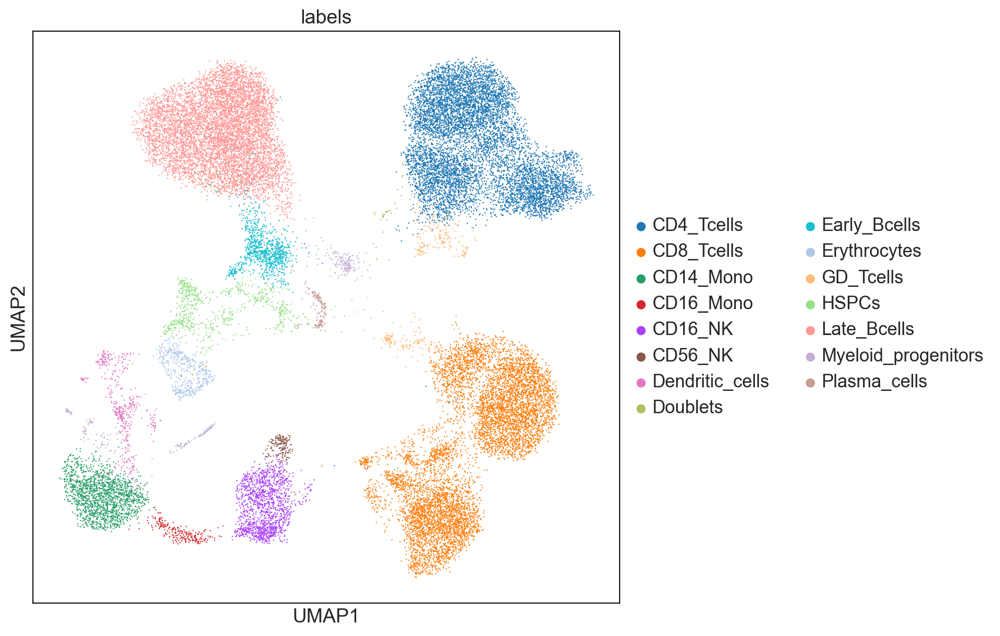

In [5]:
sc.pl.umap(adata, color='labels')

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


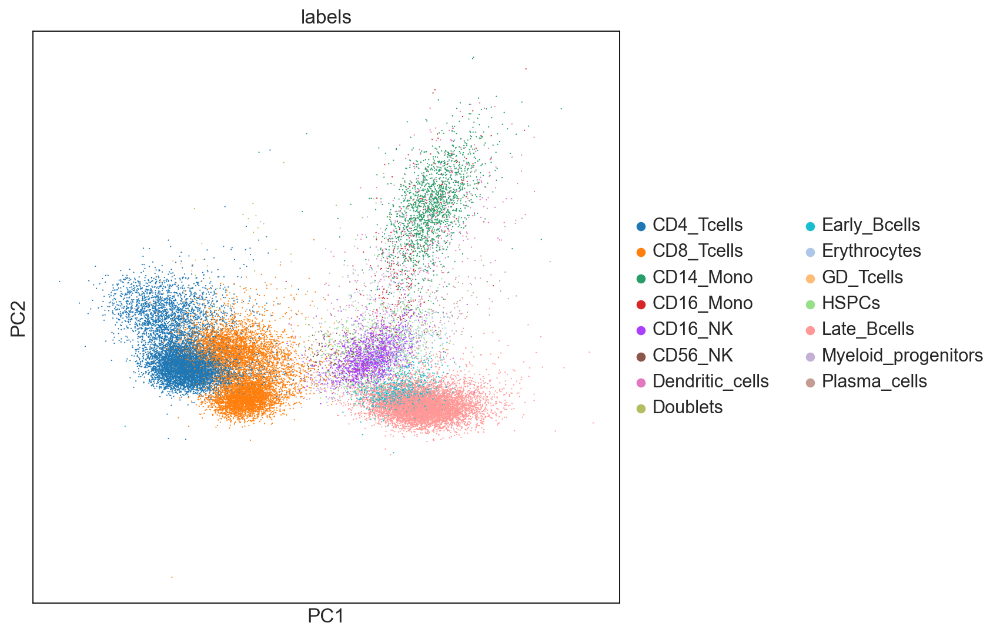

In [6]:
sc.pl.pca(adata, color='labels')

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


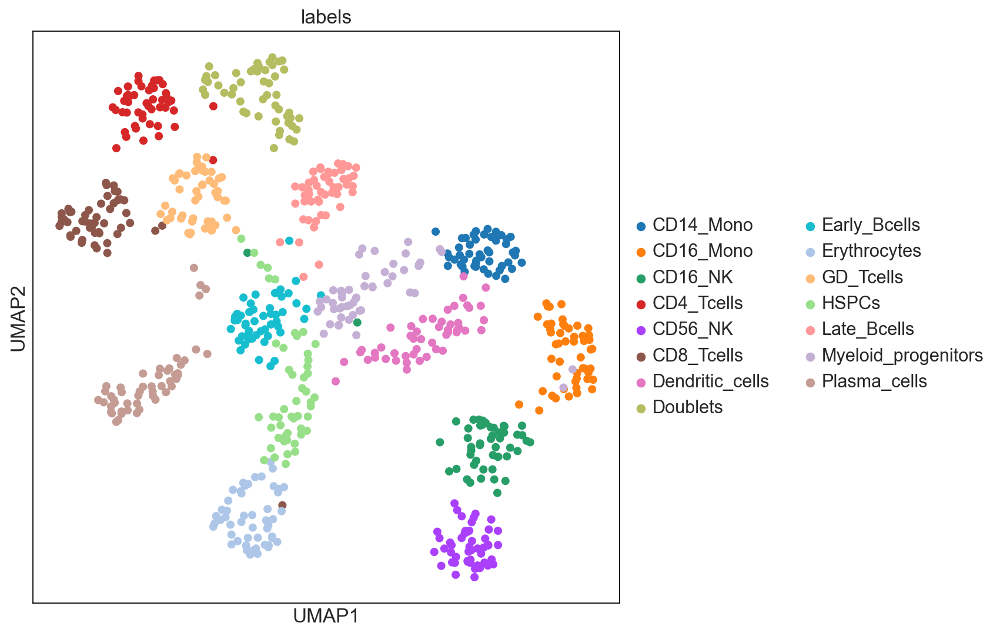

In [7]:
from FACS_Sampling.preprocessing.utils import set_reference_colors
# adata.obs['labels'] = adata.obs['labels'].astype('category')
dictionary = set_reference_colors(adata, cluster_key='labels')
cluster_key = 'labels'
label_key = 'labels'

In [8]:
ref_adata = adata.copy()
change_cmap(ref_adata, dictionary)


## Simulation

In [9]:
real_data, real_label = adata.obsm['X_pca'], adata.obs[label_key].values
sim_data_size = 1000

In [10]:
extended_labels = pd.concat([pd.Series(real_label), 
                             pd.Series(pd.Categorical(['Sim' for i in range(
                                 sim_data_size)]))])
extended_labels.reset_index(drop=True)

0         CD4_Tcells
1         CD8_Tcells
2        Late_Bcells
3         CD8_Tcells
4        Late_Bcells
            ...     
30995            Sim
30996            Sim
30997            Sim
30998            Sim
30999            Sim
Length: 31000, dtype: object

In [11]:
ad_df = adata.to_df()
generated_data = np.random.normal(size=(sim_data_size, ad_df.shape[1]))
extended_data = pd.concat([ad_df, pd.DataFrame(generated_data, columns=ad_df.columns)])
extended_data['labels'] = extended_labels.values
extended_data = extended_data.reset_index(drop=True)

In [12]:
ext_adata = create_adata(extended_data, obs_features='labels')
dictionary = set_reference_colors(ext_adata, cluster_key='labels', make_plot=False)
sc.tl.pca(ext_adata)

/Users/ekarimi/PycharmProjects/FACS_Sampling/FACS_Sampling/preprocessing/utils.py:60: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = sc.AnnData(X, obs=obs, var=var)
/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


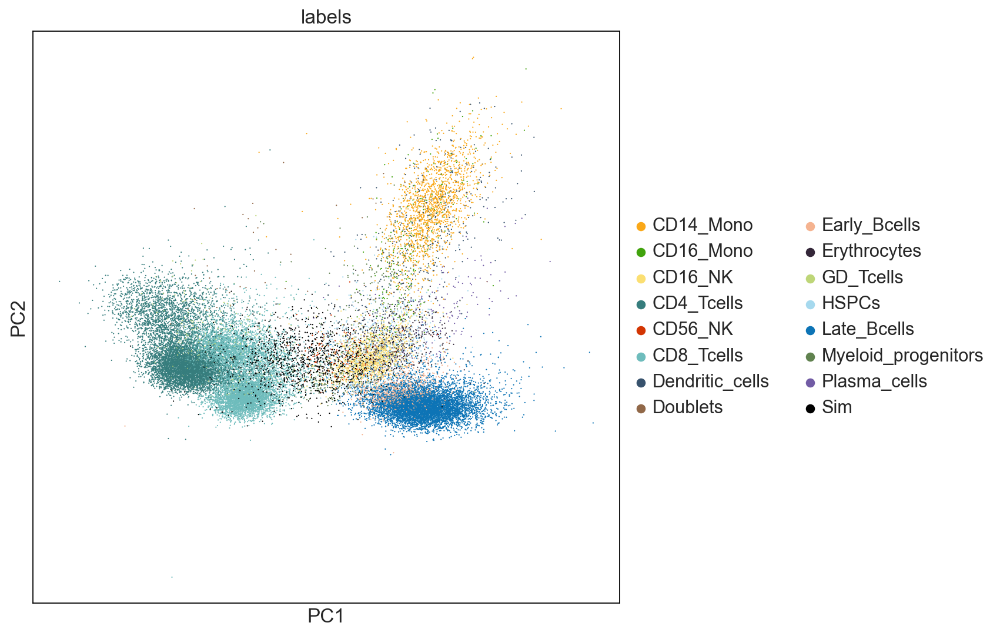

In [13]:
dictionary['Sim'] = '#000000'
change_cmap(ext_adata, dictionary,celltype_key='labels')
sc.pl.pca(ext_adata, color=label_key)

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


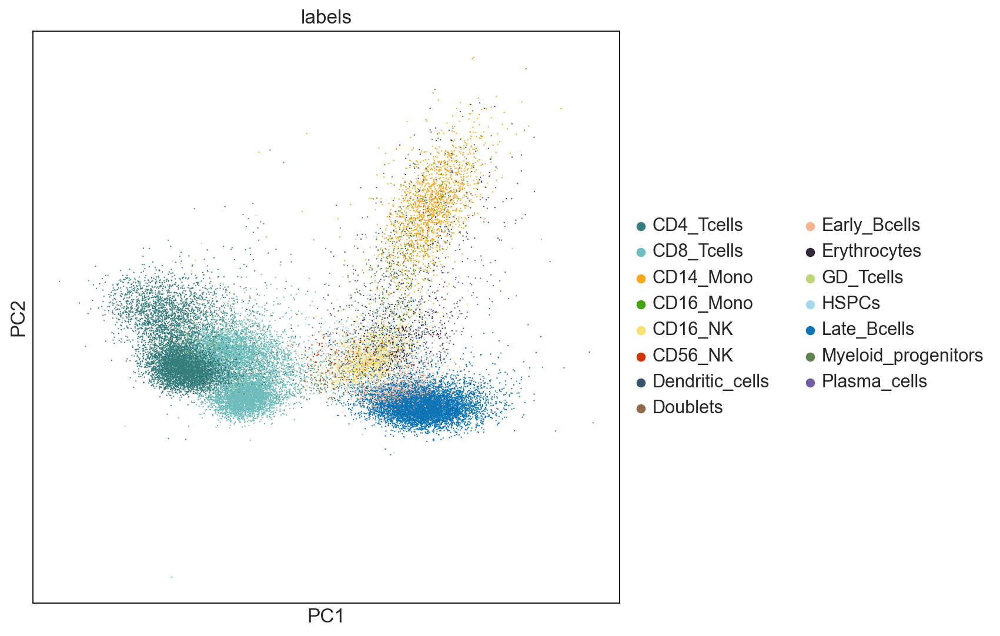

In [14]:
# plot the umap of original daat with the same pallet
change_cmap(adata, dictionary,celltype_key='labels')
sc.pl.pca(adata, color=label_key)

In [15]:
ext_adata.obsm['X_pca'].shape

(31000, 38)

In [95]:
import numpy as np
np.random.seed(1234)
# Generate 2D Gaussian data
mean = [0, -3]
cov = [[0.05, 0], [0, 0.05]]  # diagonal covariance
fake_data = np.random.multivariate_normal(mean, cov, 1000)

# Generate 2D Gaussian data to multiply to the embedding to bring it to high-dim
mean = [0, 0]
cov = [[1, 0], [0, 1]]  # diagonal covariance
factor = np.random.multivariate_normal(mean, cov, adata.shape[1])

# put the generated numbers in their place in ext_adata
ext_adata.obsm['X_pca'][adata.shape[0]:, ] = ext_adata.obsm['X_pca'][:fake_data.shape[0], ]
ext_adata.obsm['X_pca'][adata.shape[0]:, :2] = fake_data

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


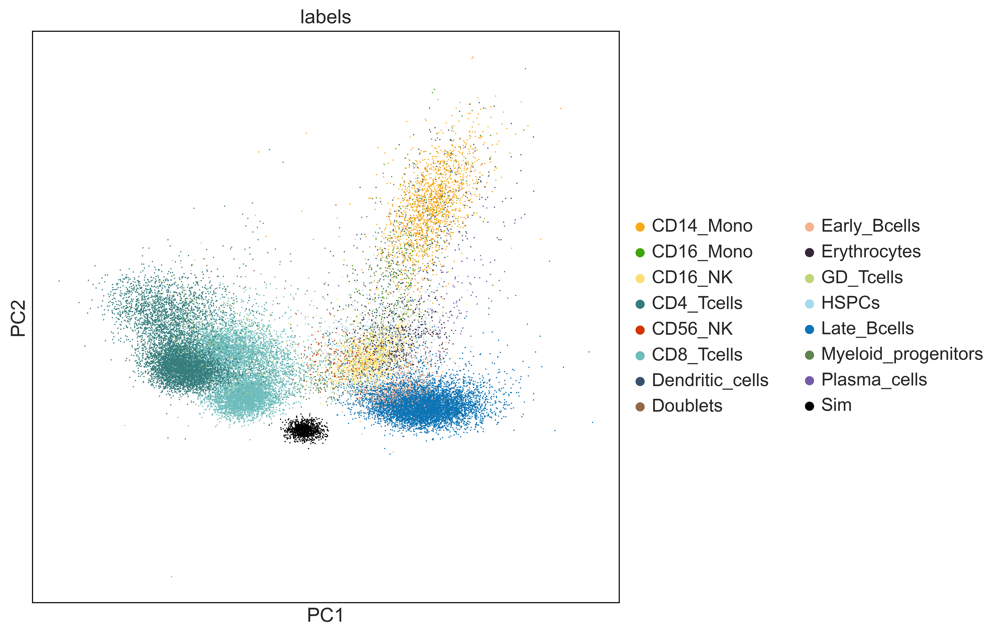

In [96]:
sc.pl.pca(ext_adata, color=label_key)

In [97]:
# test for generating high dim data
adata_t1 = ext_adata.copy()
adata_t1.X = (ext_adata.varm["PCs"] @ ext_adata.obsm["X_pca"].T).T

In [98]:
del adata_t1.obsm
del adata_t1.uns['pca']


/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


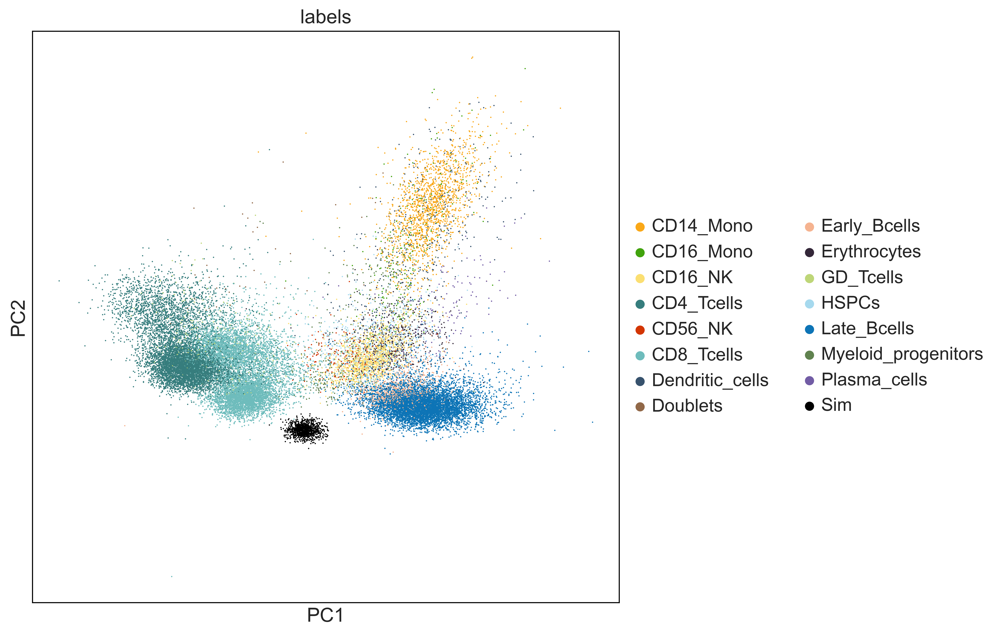

In [99]:
sc.pp.neighbors(adata_t1)
sc.tl.pca(adata_t1)
sc.pl.pca(adata_t1, color=label_key)


In [105]:
import numpy as np
from sklearn.decomposition import PCA

# Set the size of the data set
N = 1000

# Generate 7 1-dimensional arrays representing 7 identifiable classes
class1 = np.random.normal(1, 0.1, N)
class2 = np.random.normal(2, 0.2, N)
class3 = np.random.normal(3, 0.3, N)
class4 = np.random.normal(4, 0.4, N)
class5 = np.random.normal(5, 0.5, N)
class6 = np.random.normal(6, 0.6, N)
class7 = np.random.normal(7, 0.7, N)

# Generate a 10-dimensional array representing the mixed class of data
mixed_class = np.random.normal(0, 1, (N, 10))

# Add the values of each dimension in the mixed class to create a new 1-dimensional array representing the "summed" mixed class
summed_mixed_class = mixed_class.sum(axis=1)

# Add the summed mixed class to each of the 7 1-dimensional arrays to create 8 1-dimensional arrays in total
class1_with_mixed = class1 + summed_mixed_class
class2_with_mixed = class2 + summed_mixed_class
class3_with_mixed = class3 + summed_mixed_class
class4_with_mixed = class4 + summed_mixed_class
class5_with_mixed = class5 + summed_mixed_class
class6_with_mixed = class6 + summed_mixed_class
class7_with_mixed = class7 + summed_mixed_class

# Combine the 8 1-dimensional arrays into a 10-dimensional array representing the data set
data = np.concatenate((class1_with_mixed.reshape(N,1), class2_with_mixed.reshape(N,1), class3_with_mixed.reshape(N,1), class4_with_mixed.reshape(N,1), class5_with_mixed.reshape(N,1), class6_with_mixed.reshape(N,1), class7_with_mixed.reshape(N,1), mixed_class), axis=1)

# Perform PCA to create a 2-dimensional projection of the data set
pca = PCA(n_components=2)
proj = pca.fit_transform(data)


SyntaxError: incomplete input (1449389408.py, line 36)

In [104]:
sim_data.shape

(1000, 17)

# from this point was in the last version and in the new version will be updated

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


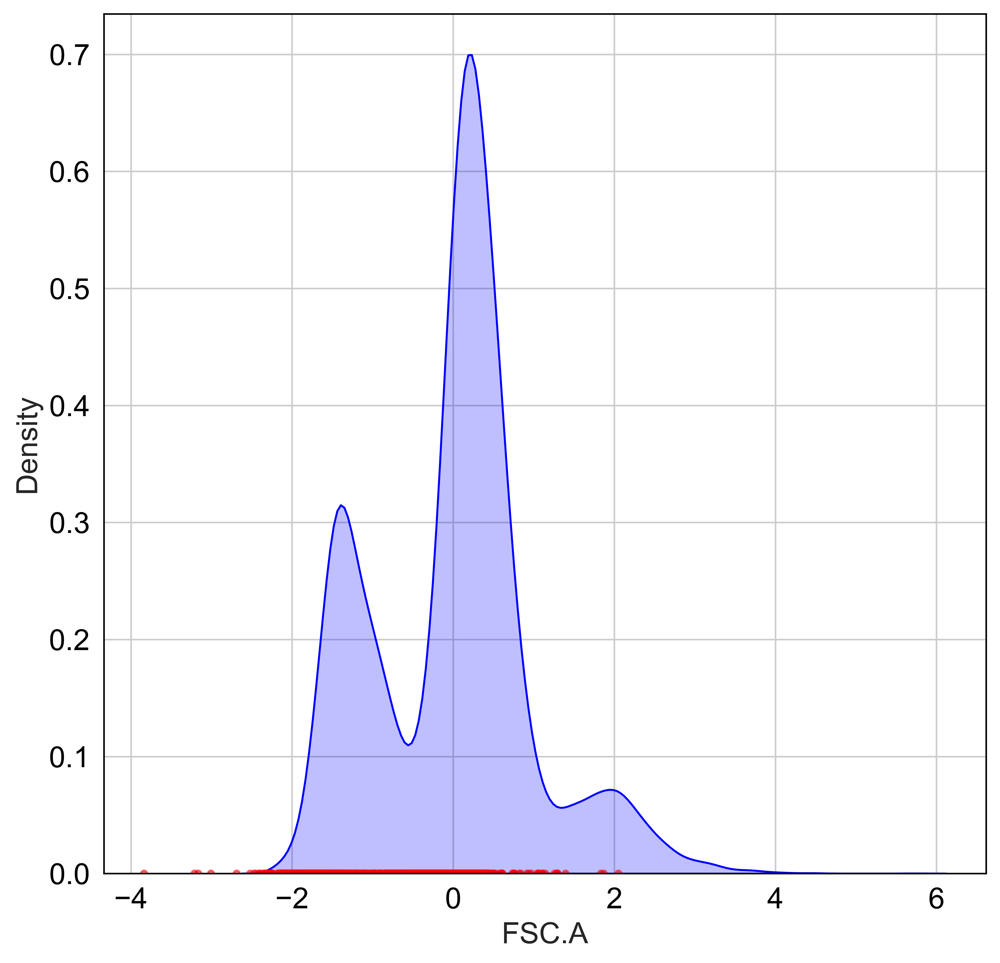

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


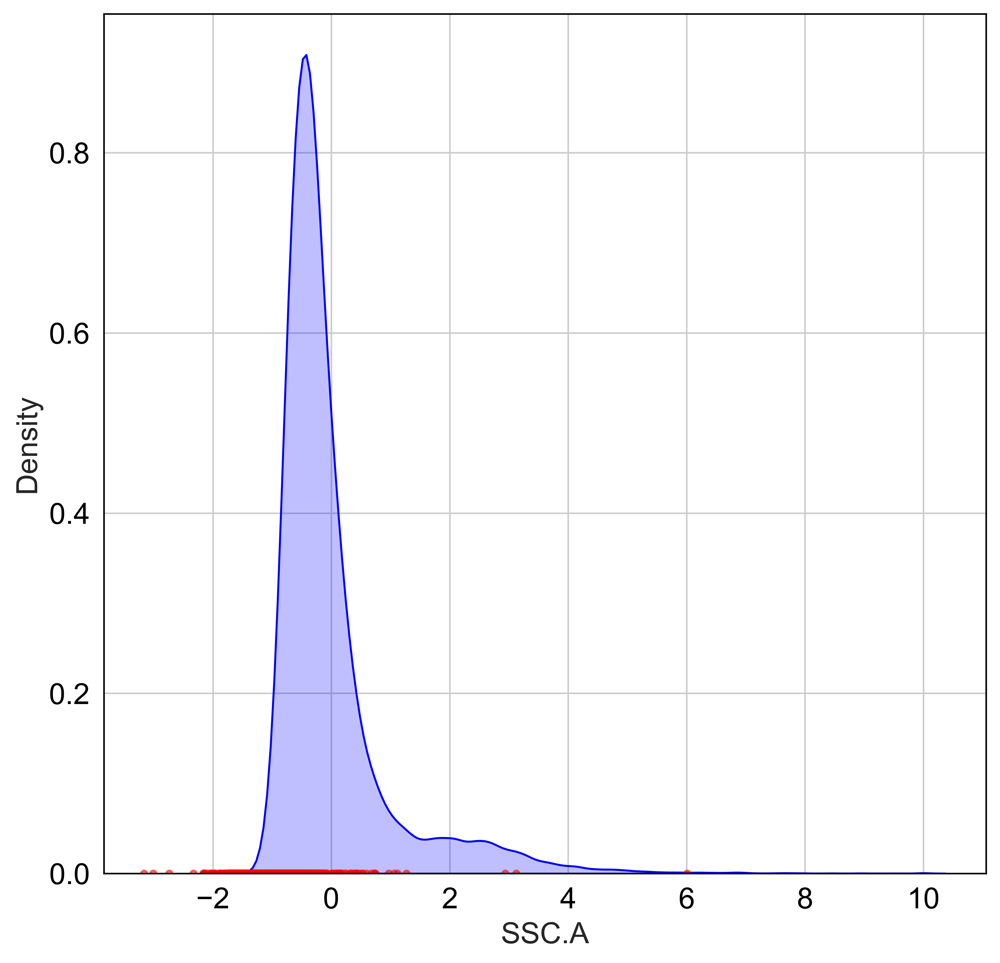

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


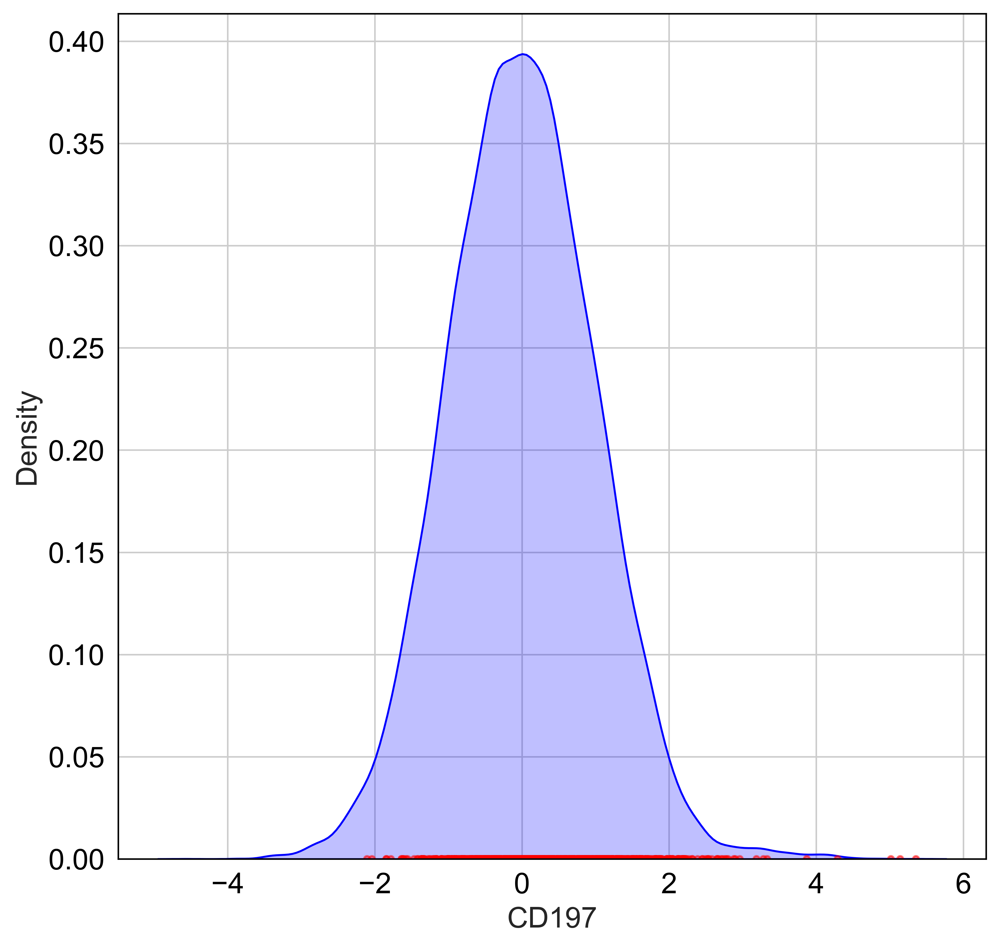

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


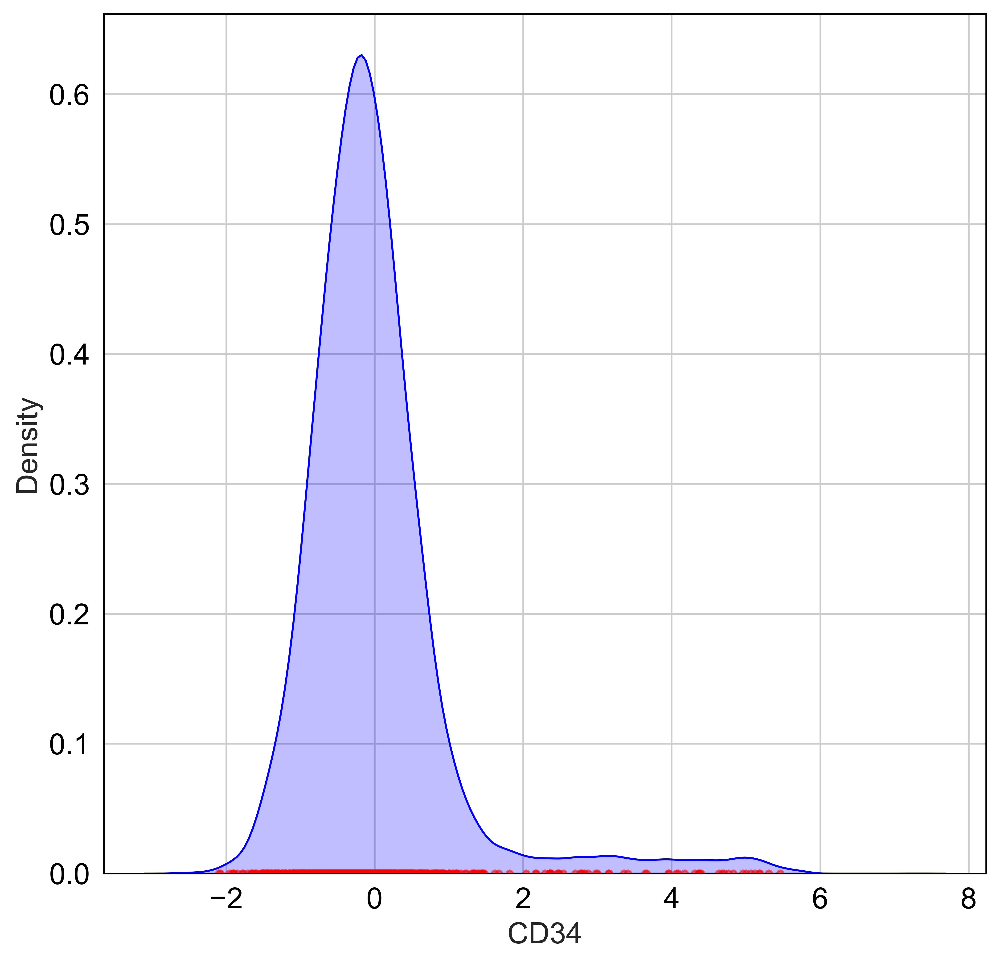

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


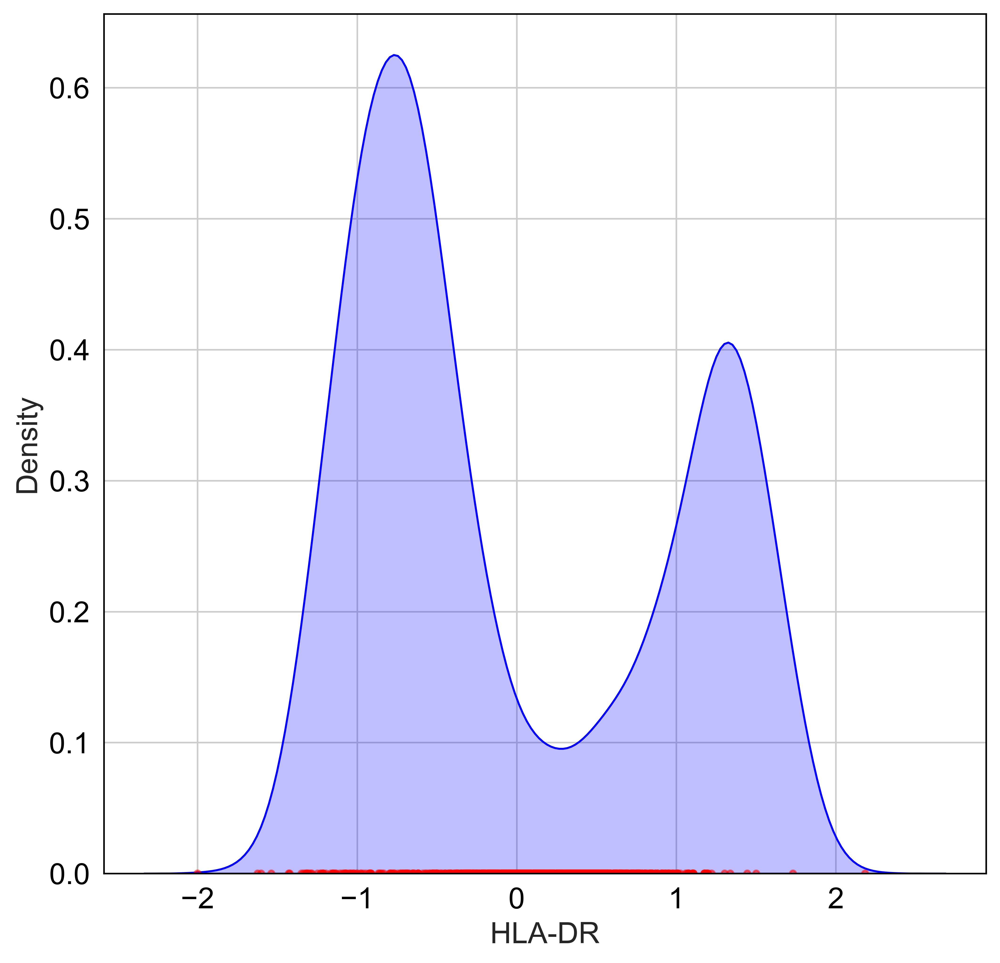

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


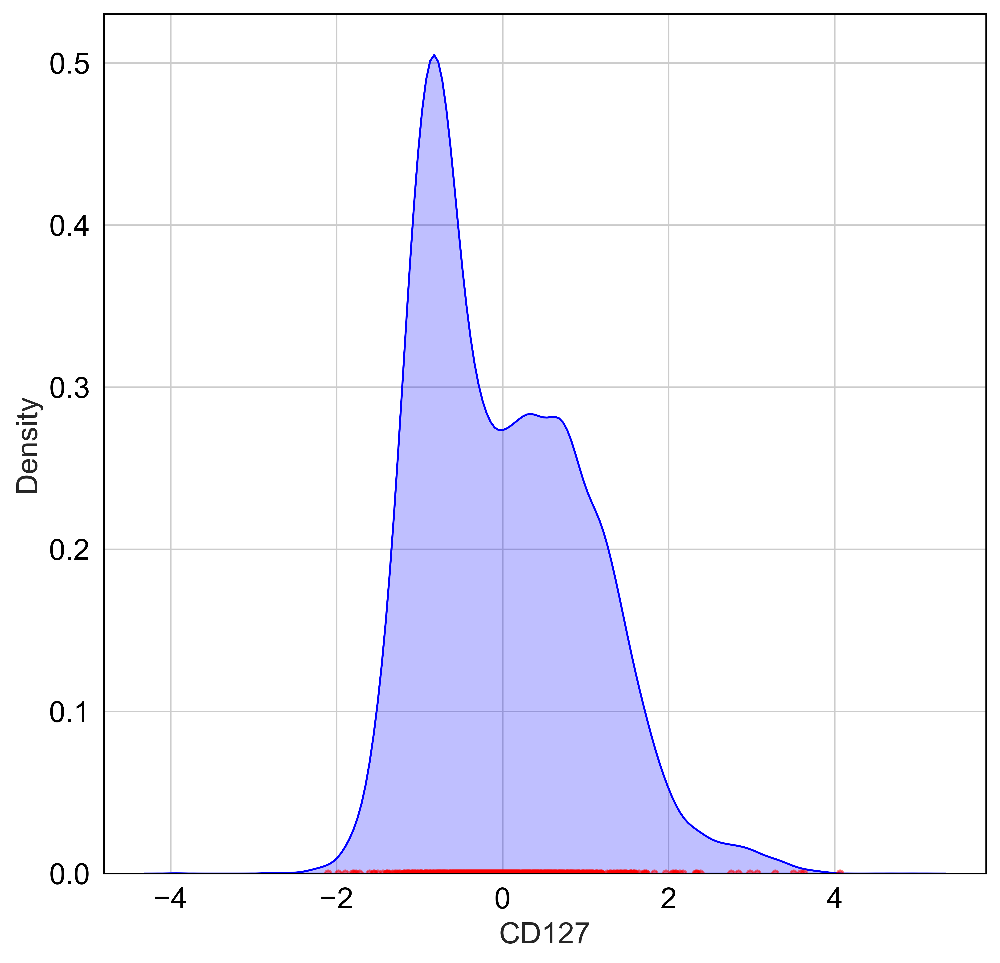

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


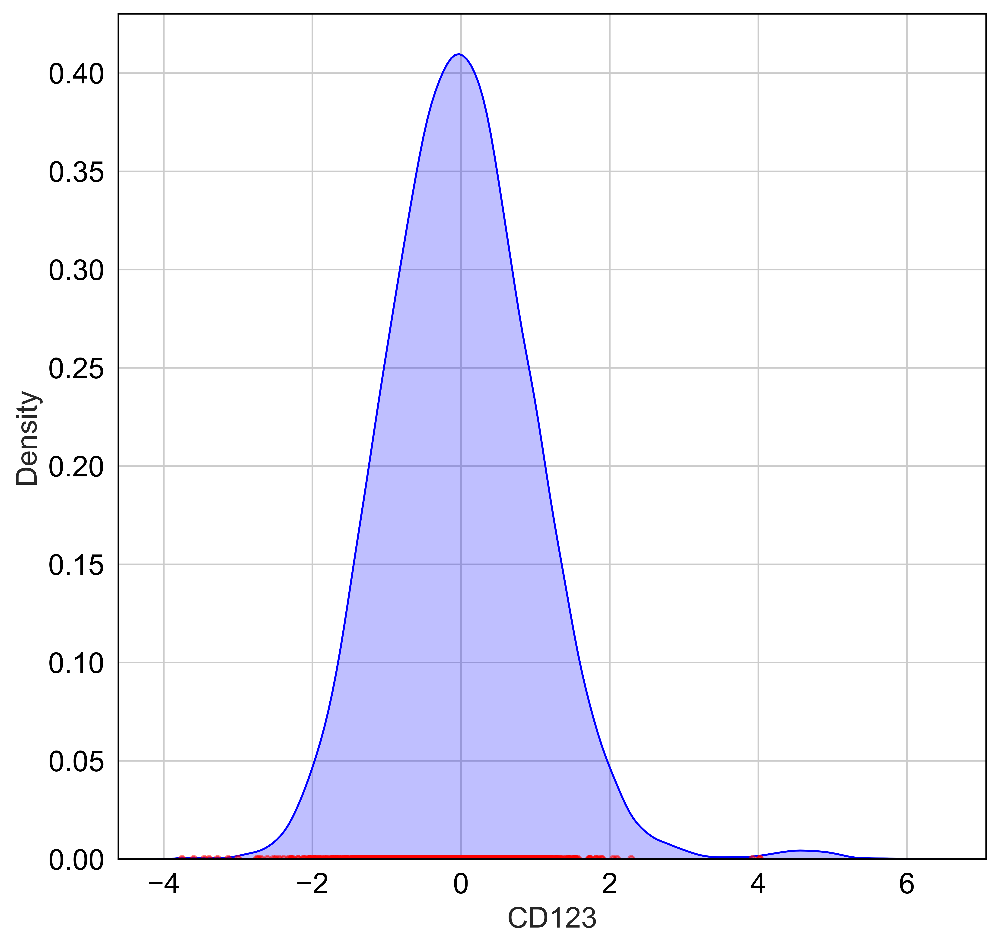

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


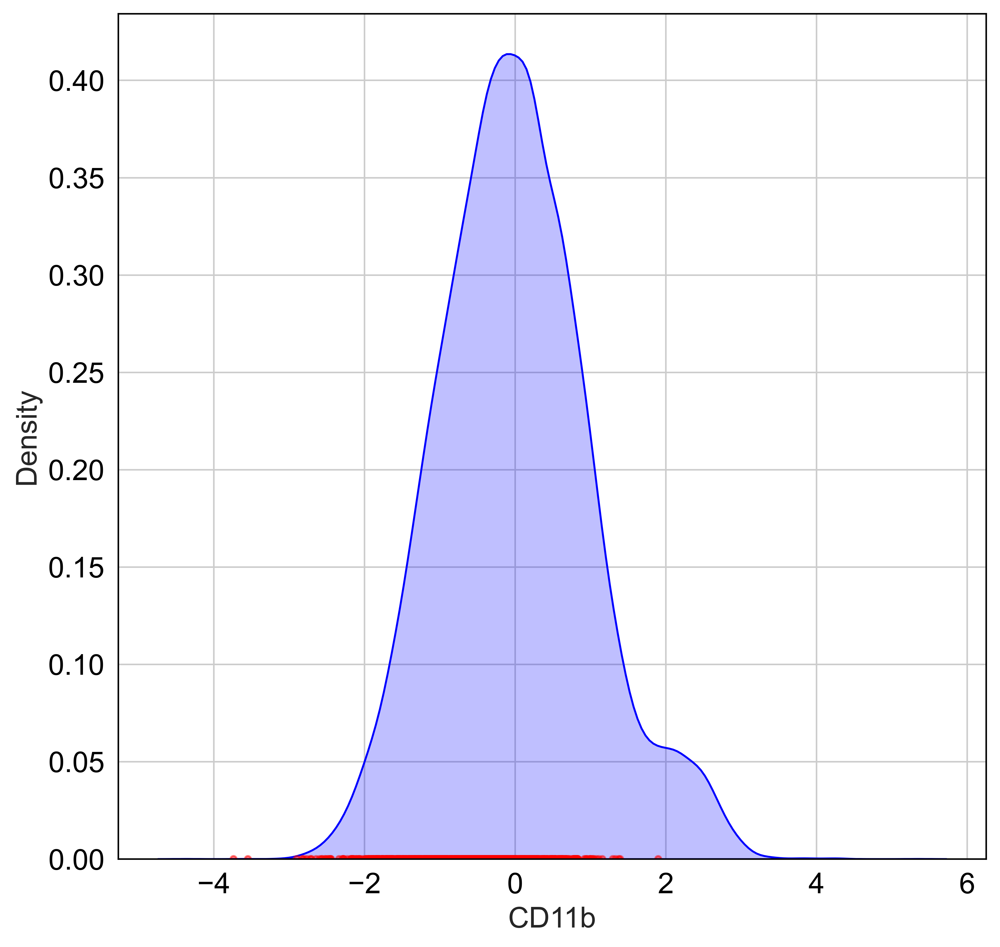

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


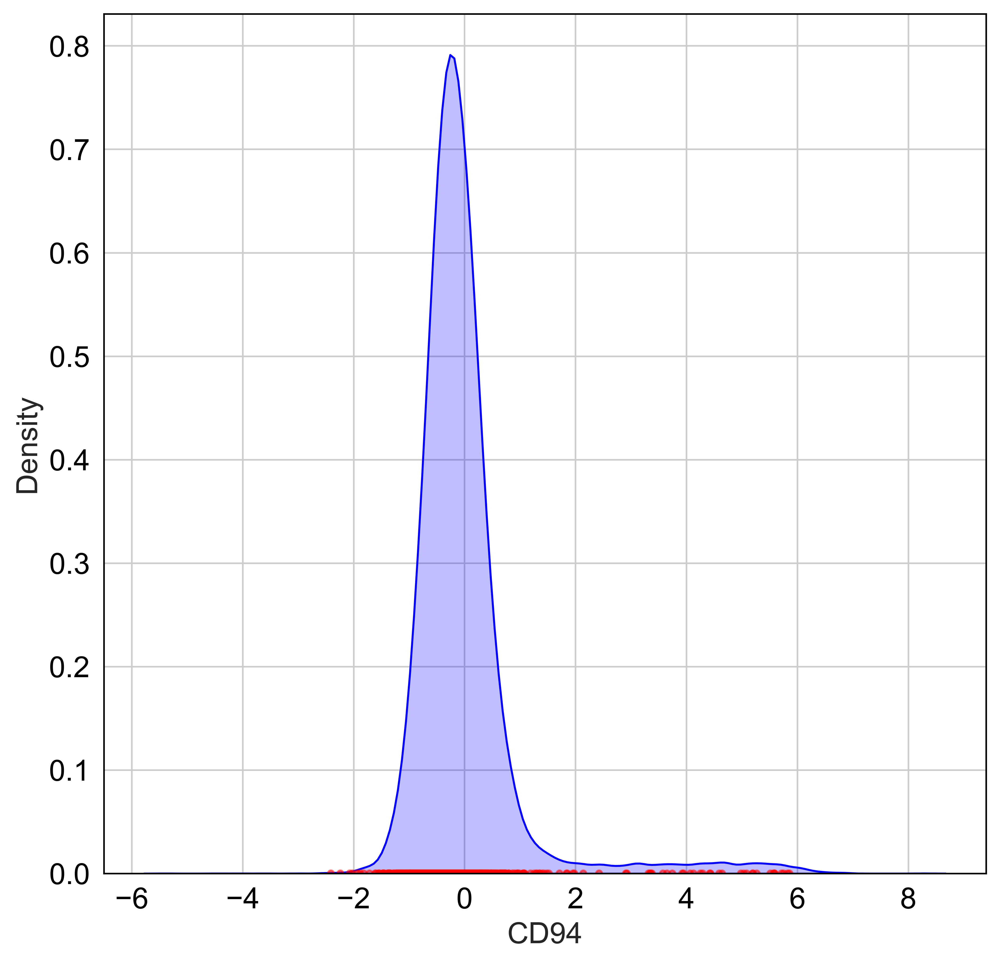

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


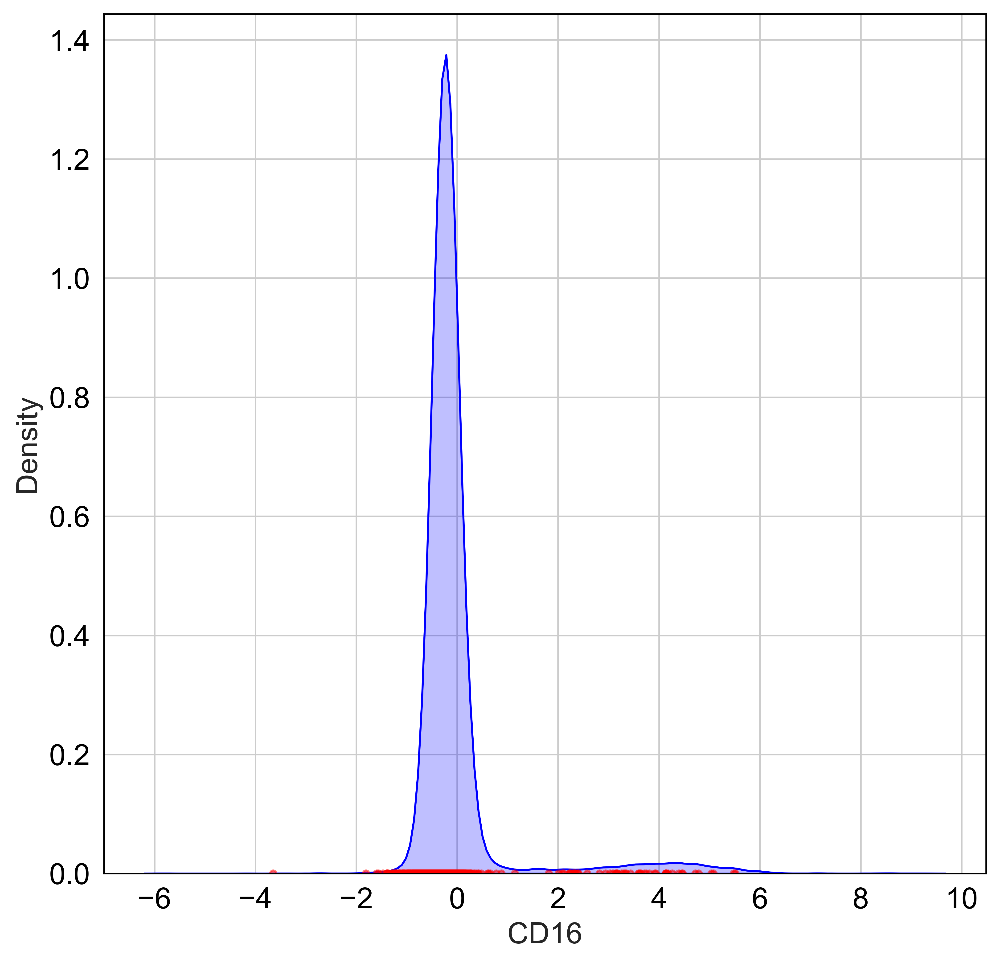

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


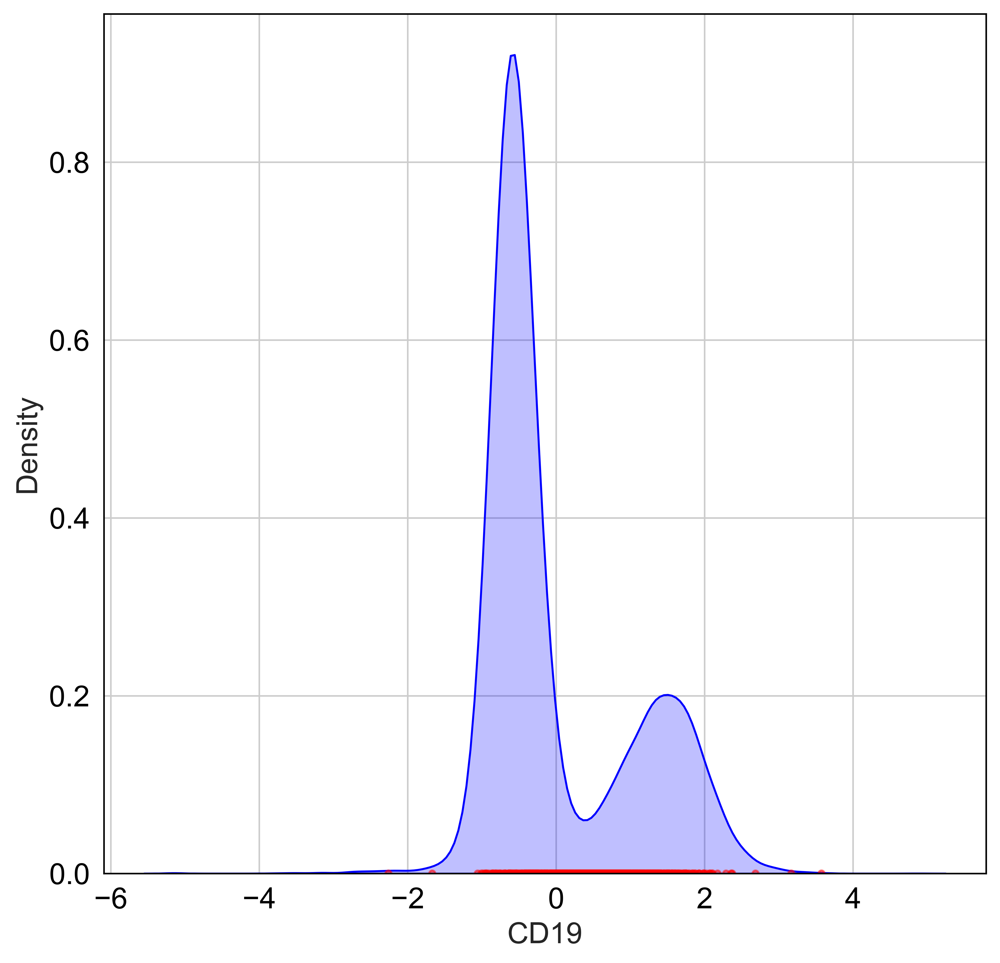

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


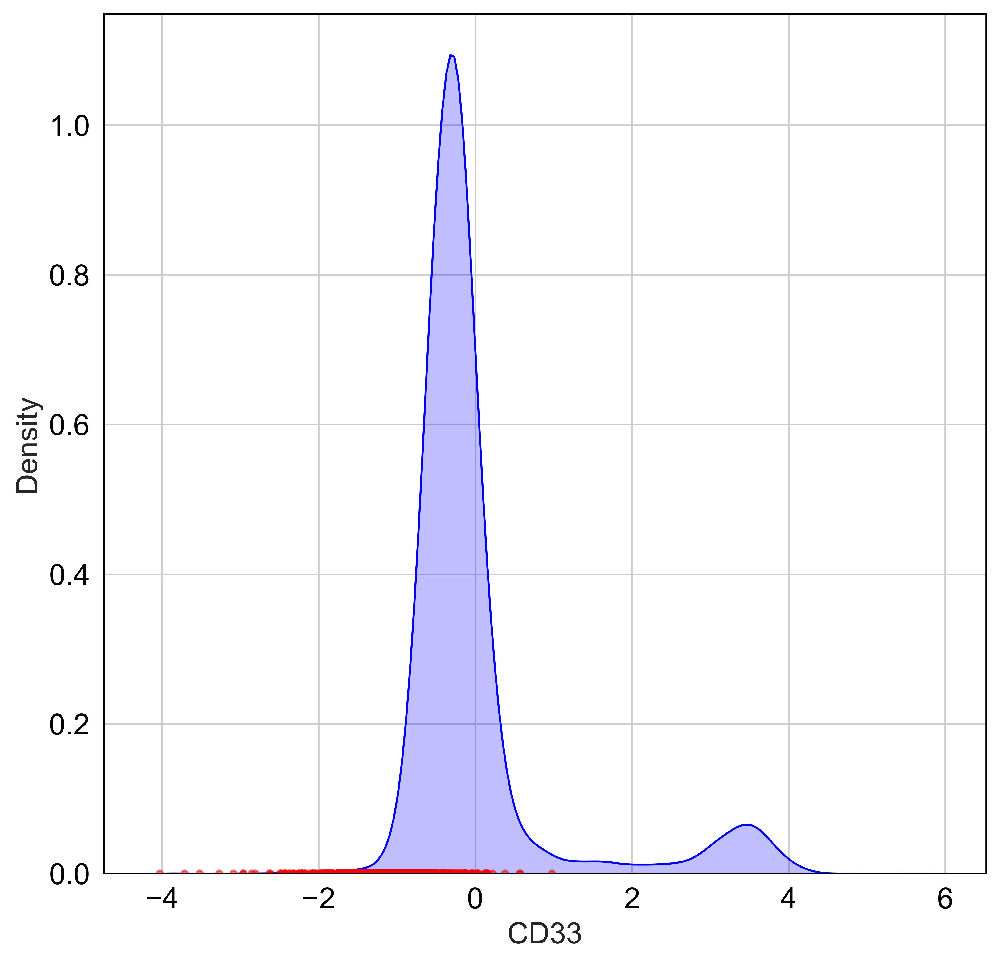

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


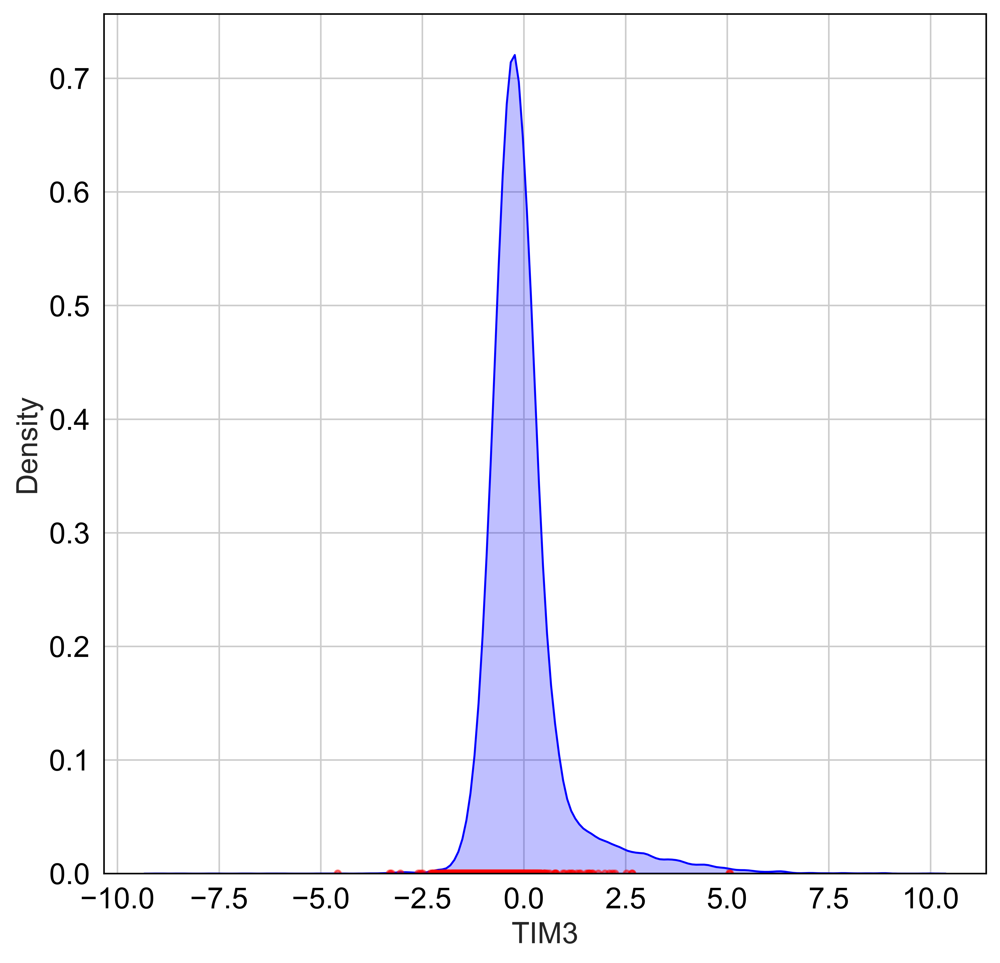

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


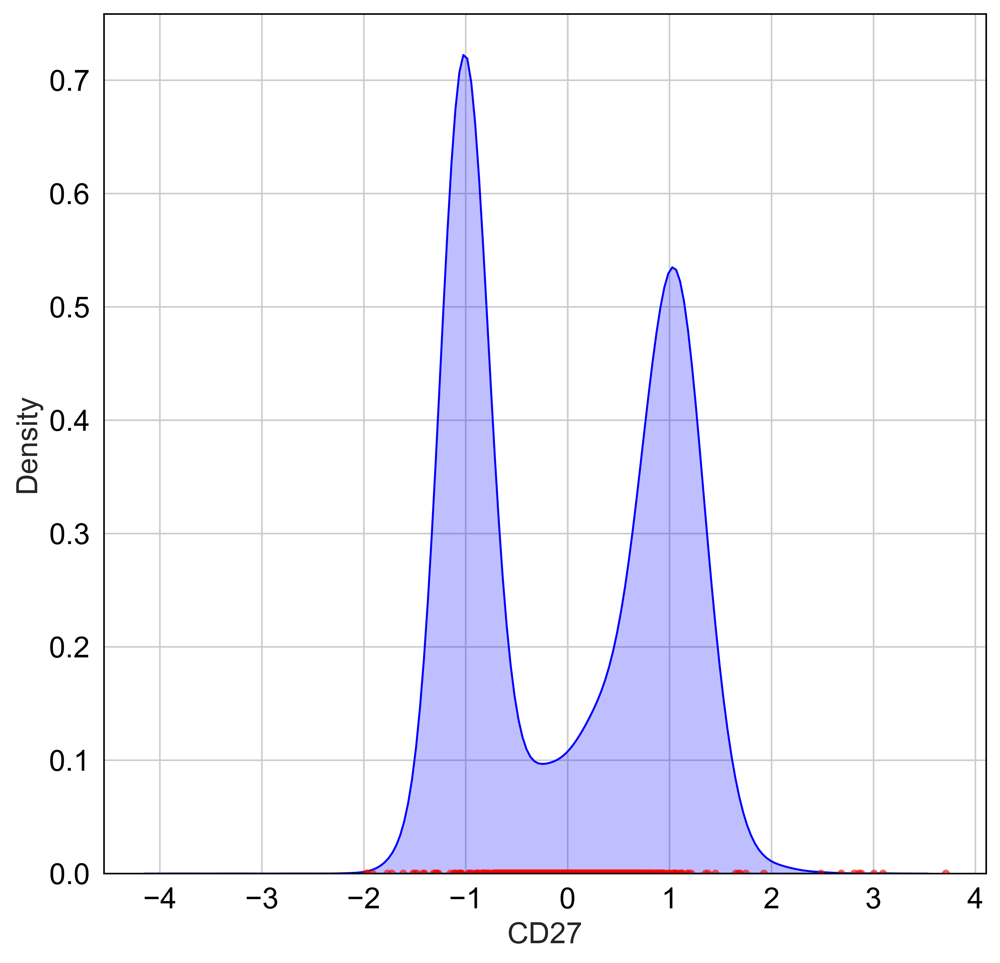

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


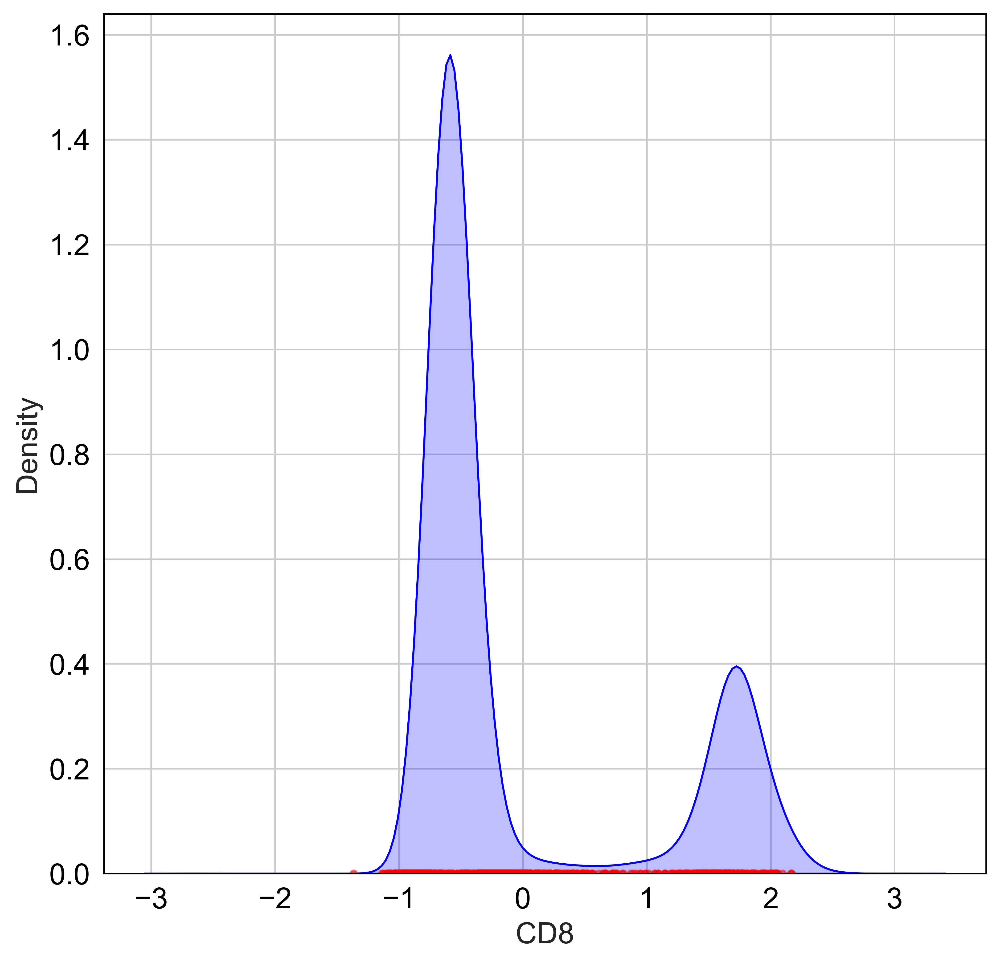

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


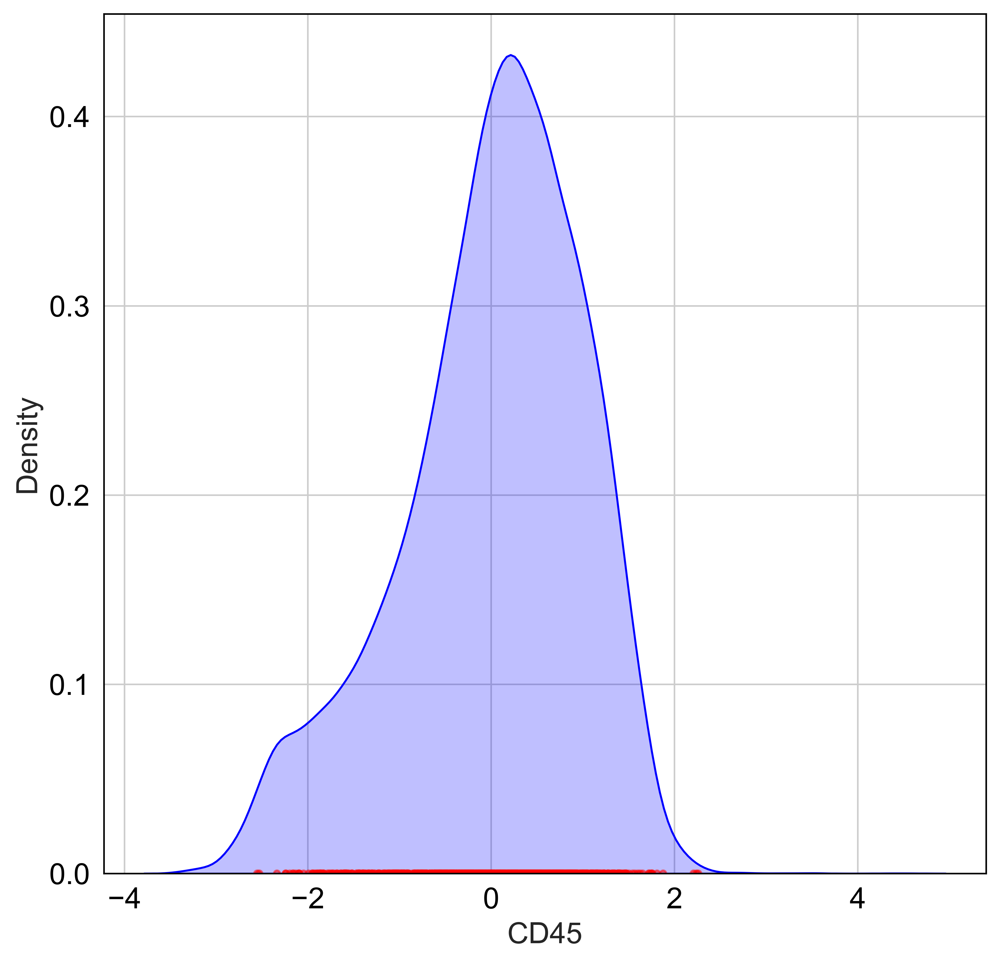

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


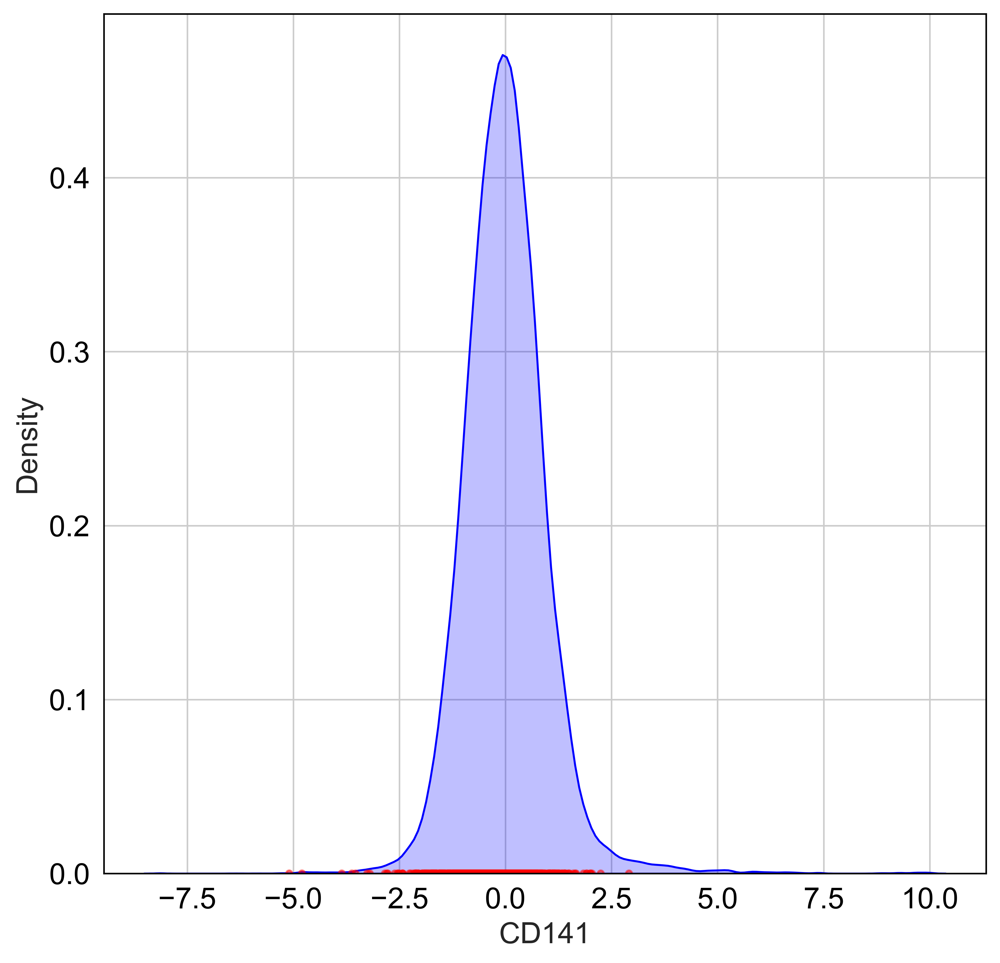

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


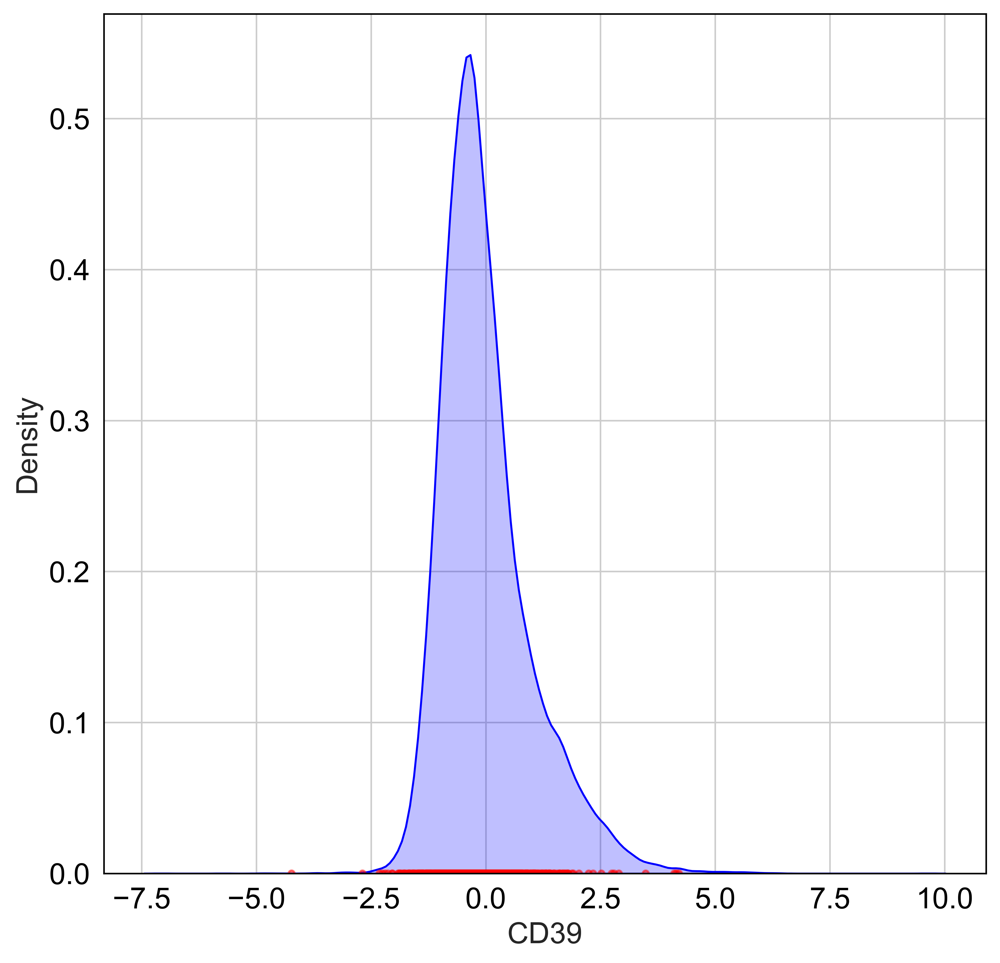

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


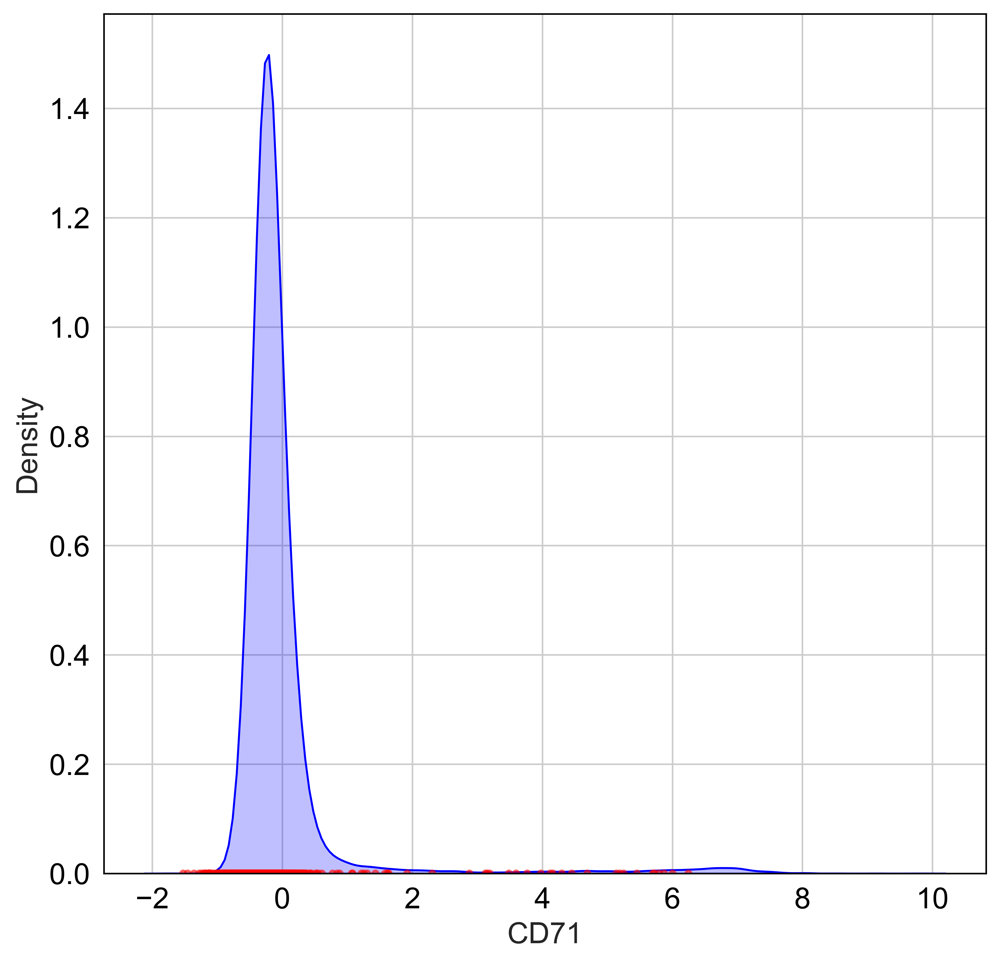

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


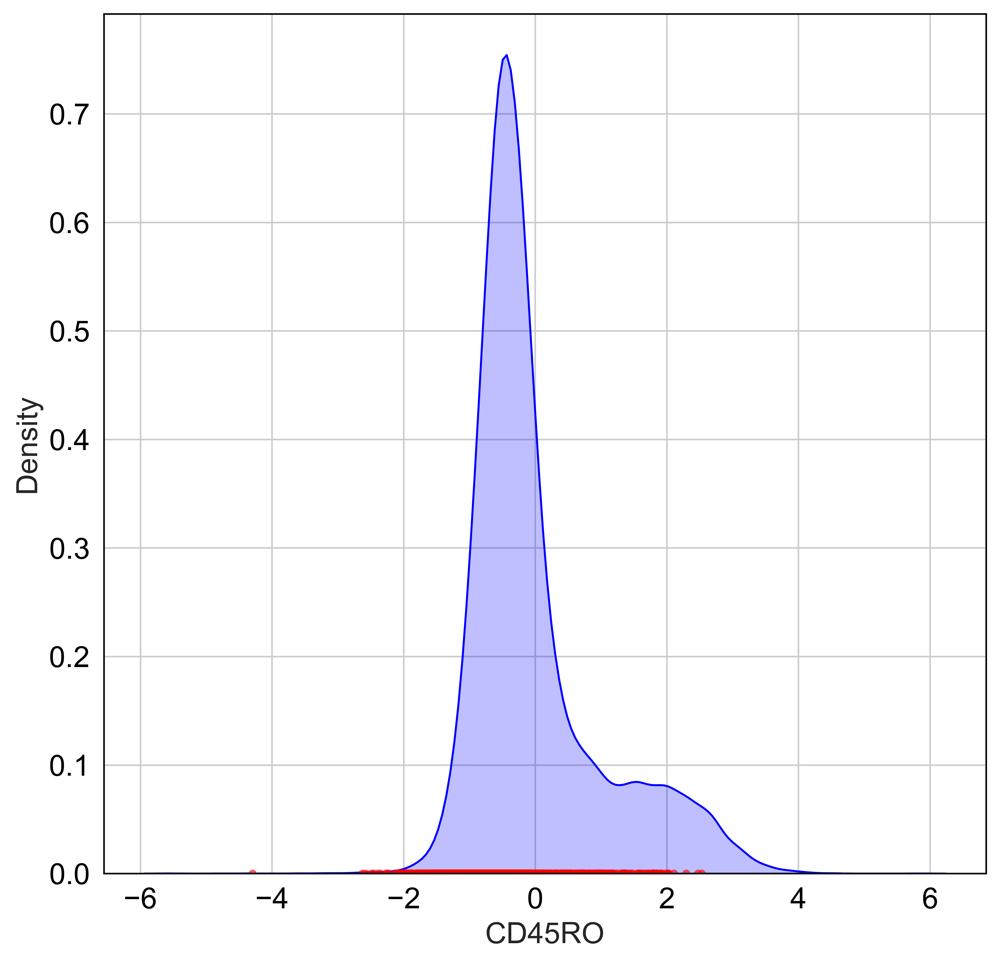

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


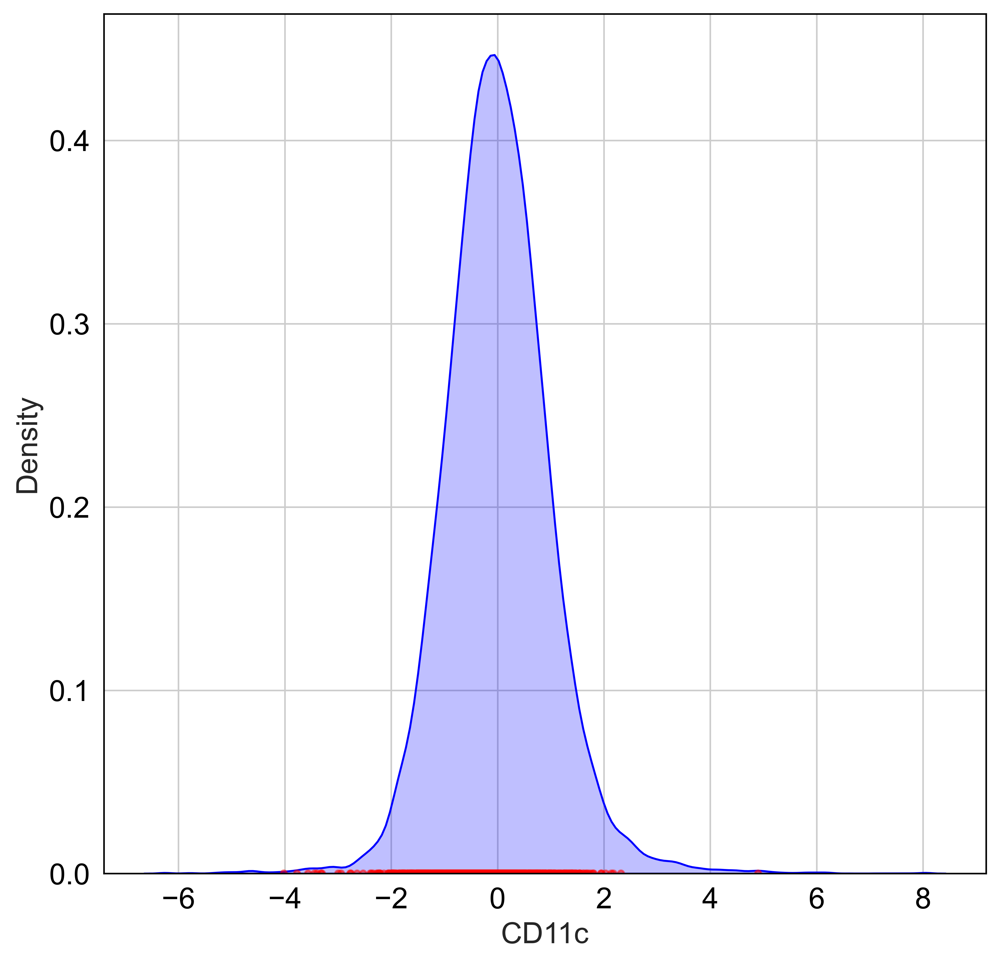

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


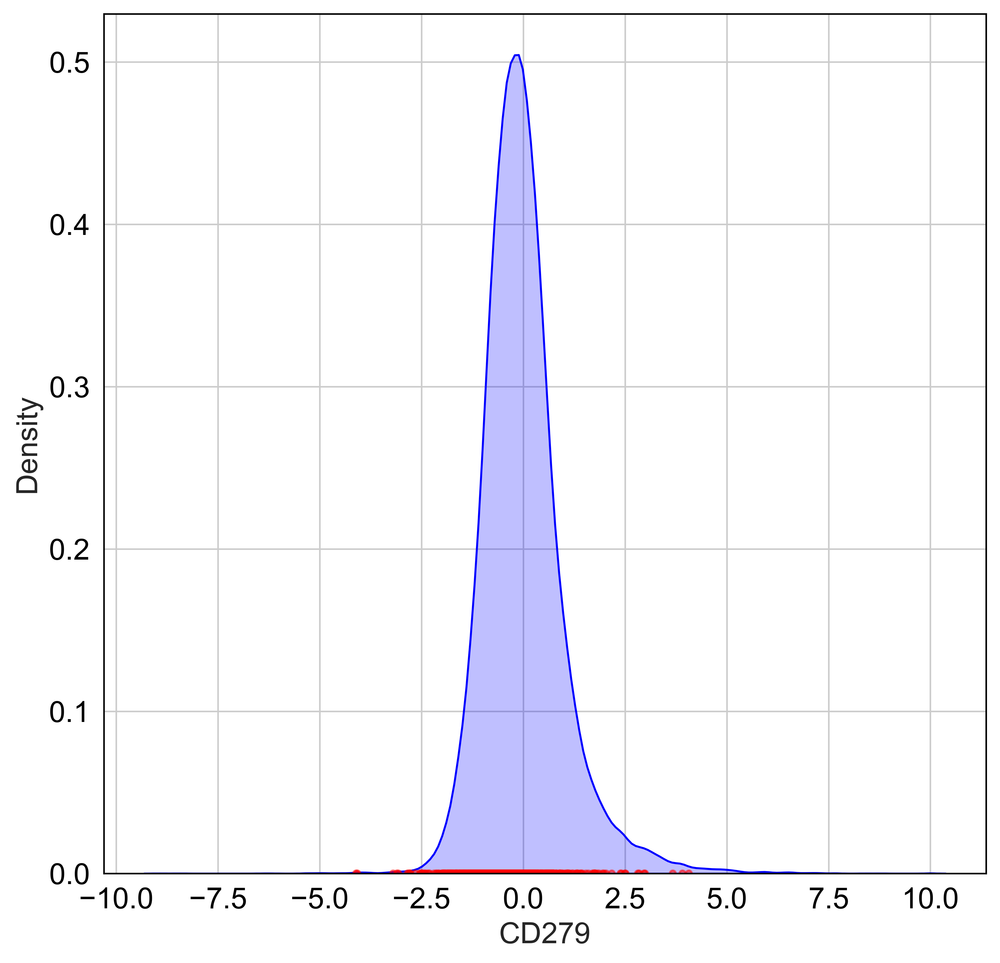

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


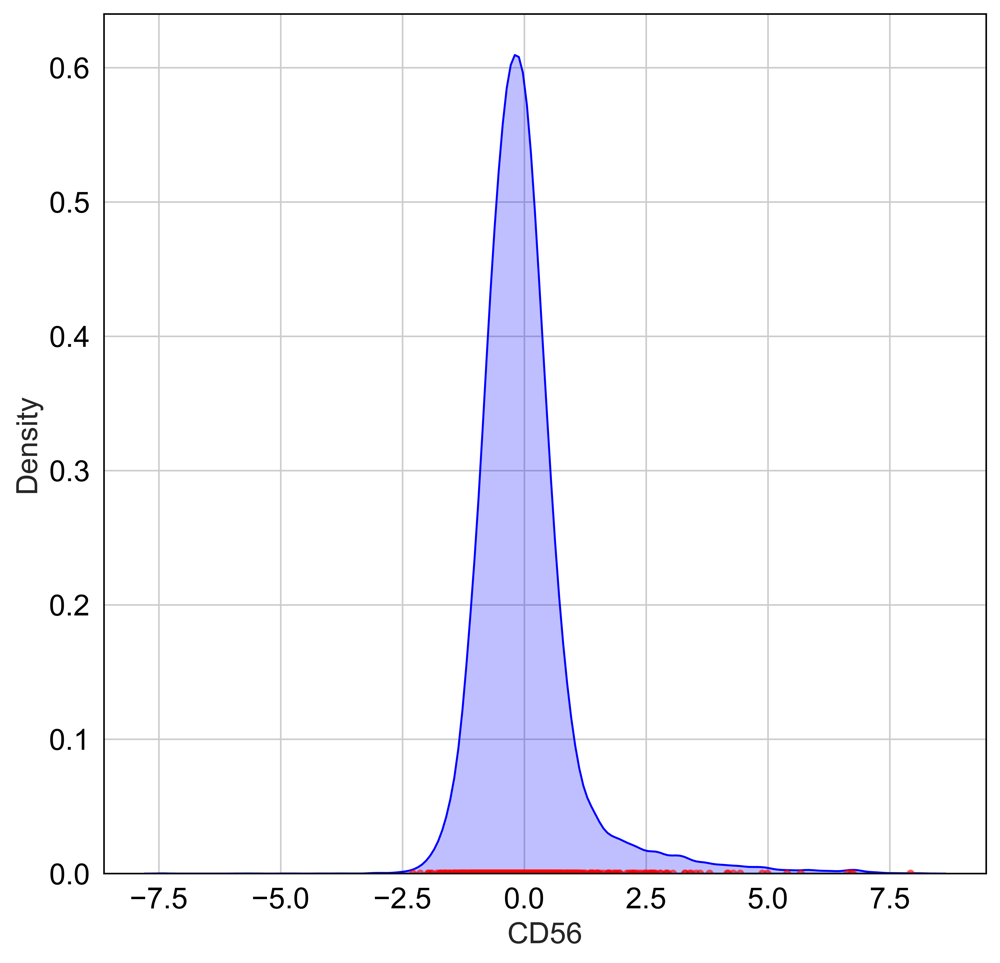

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


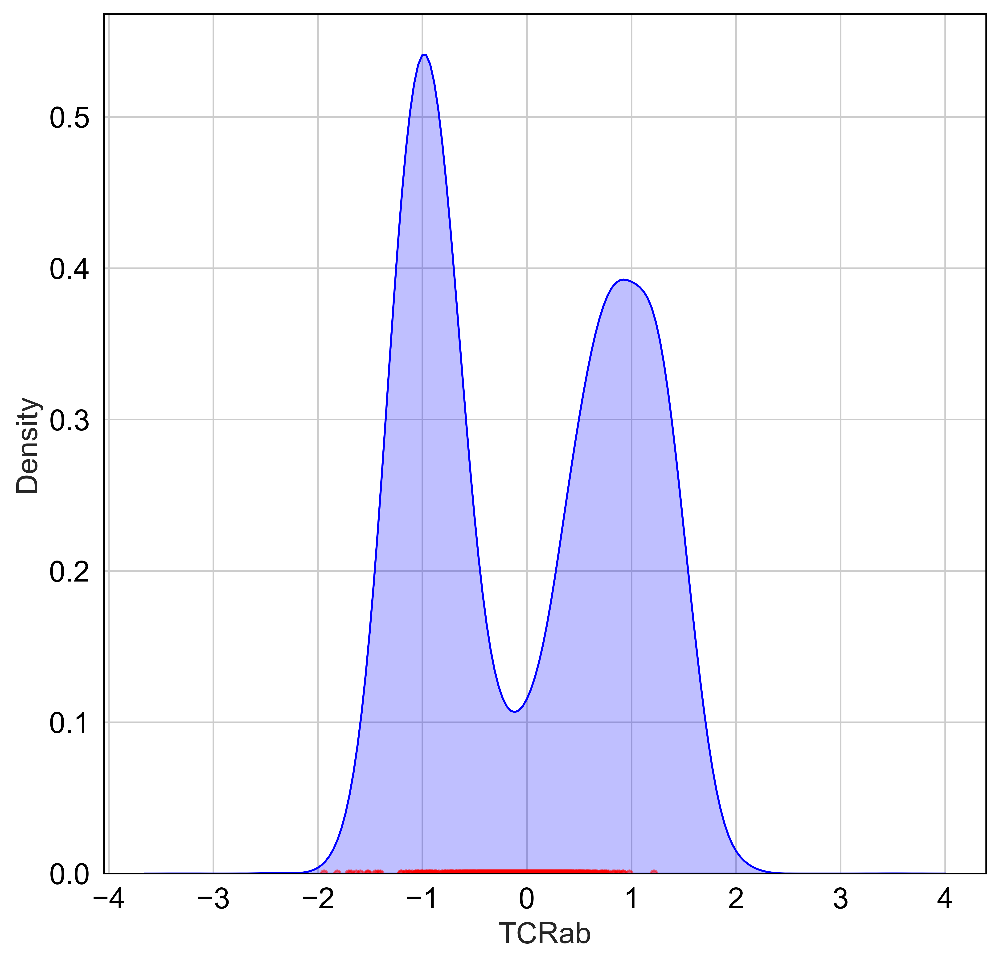

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


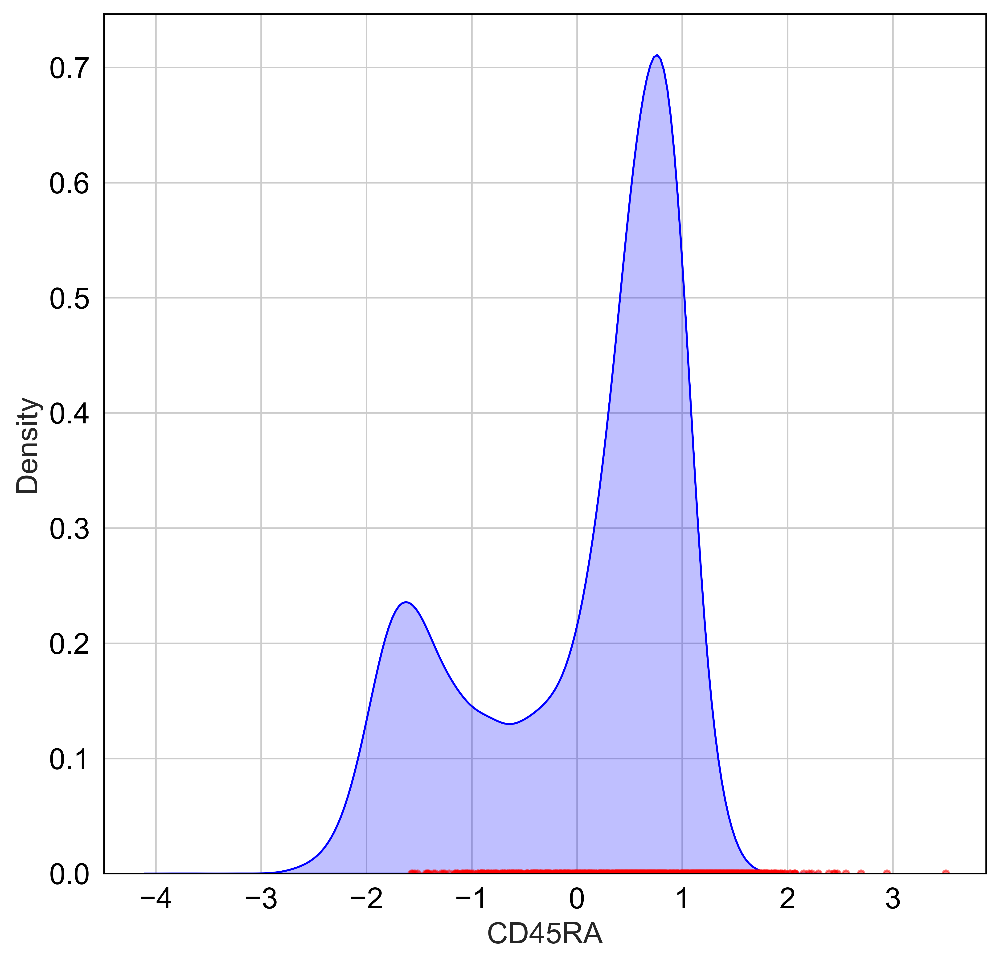

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


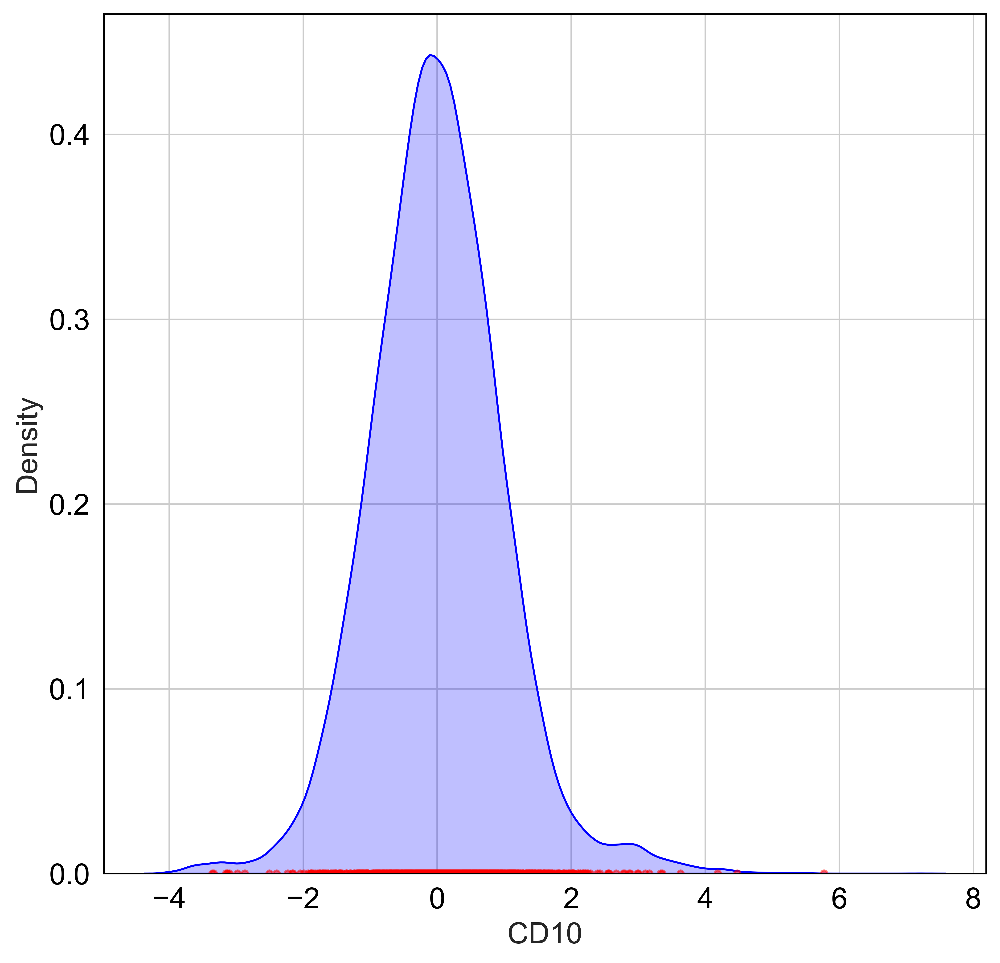

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


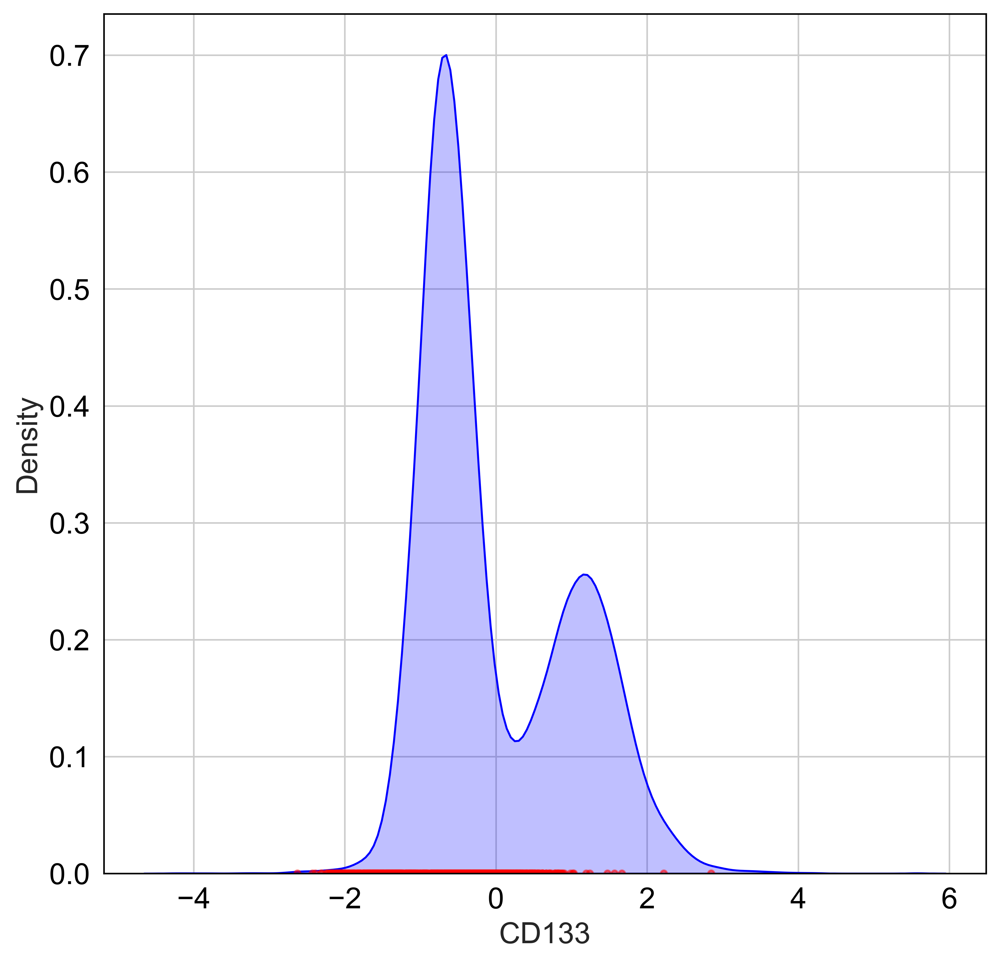

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


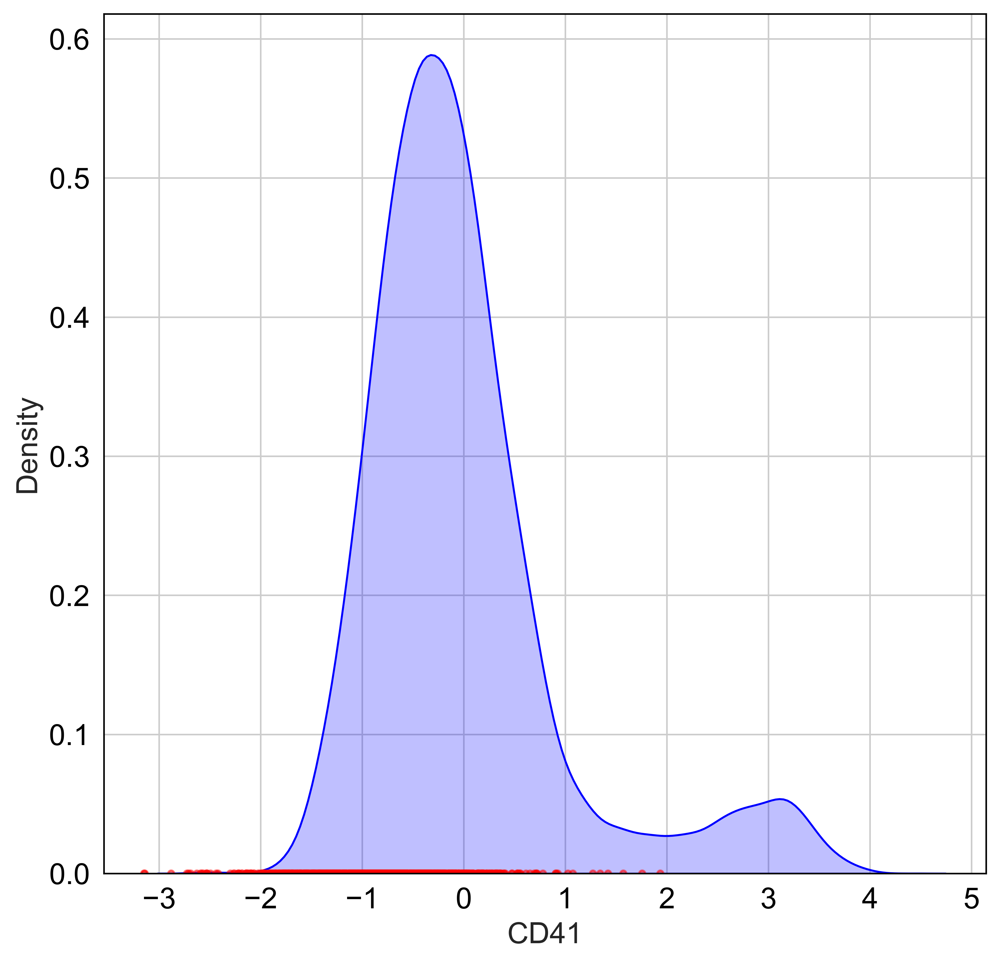

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


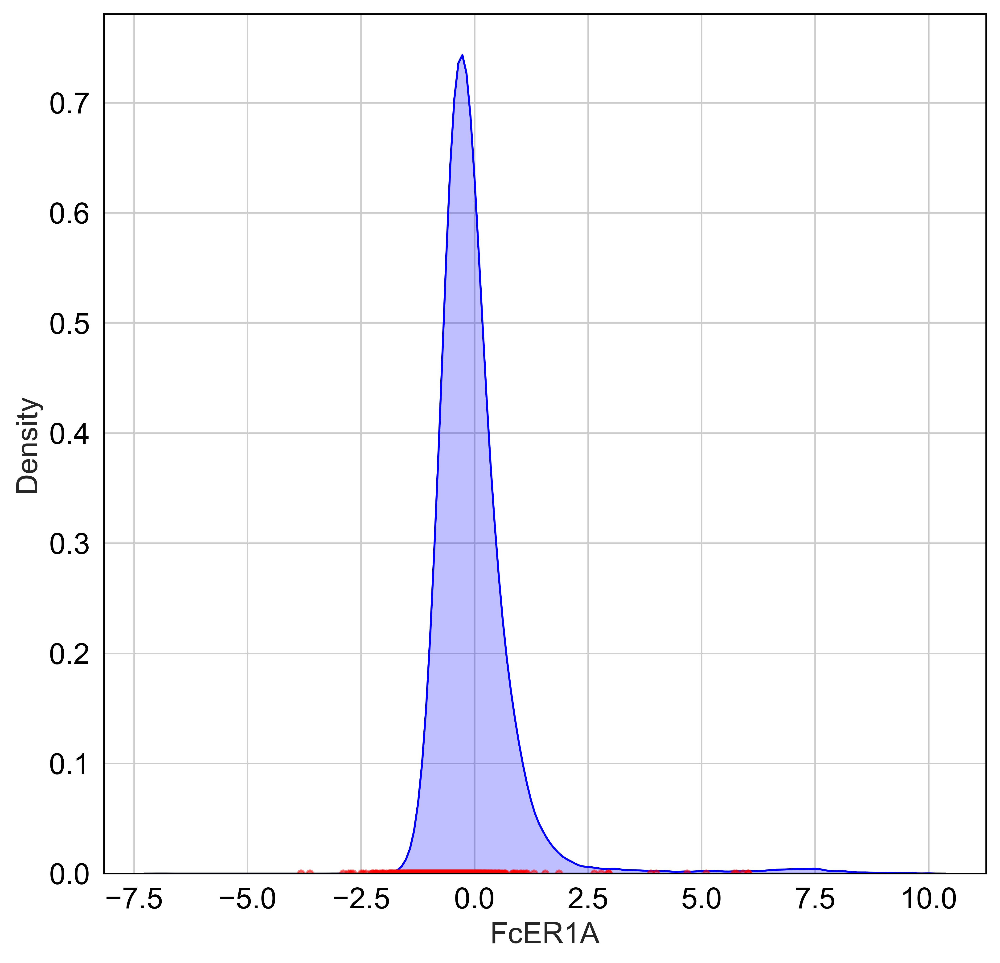

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


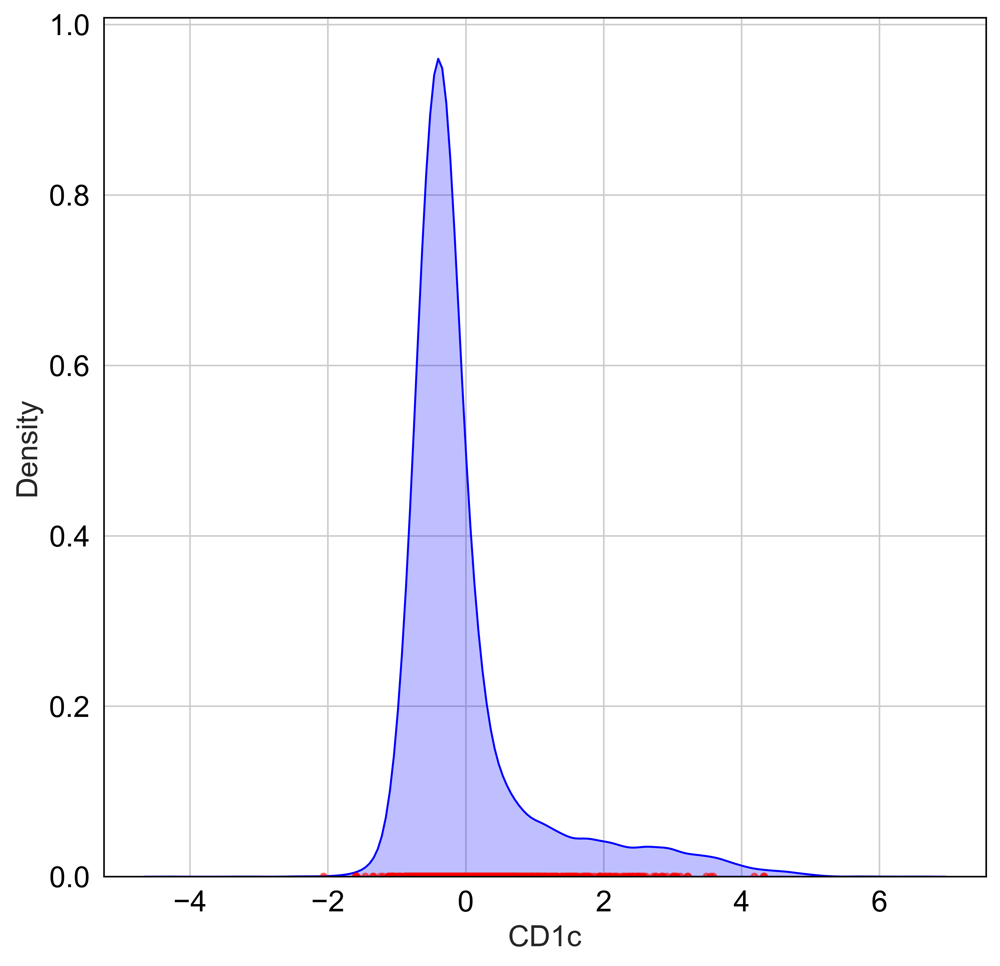

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


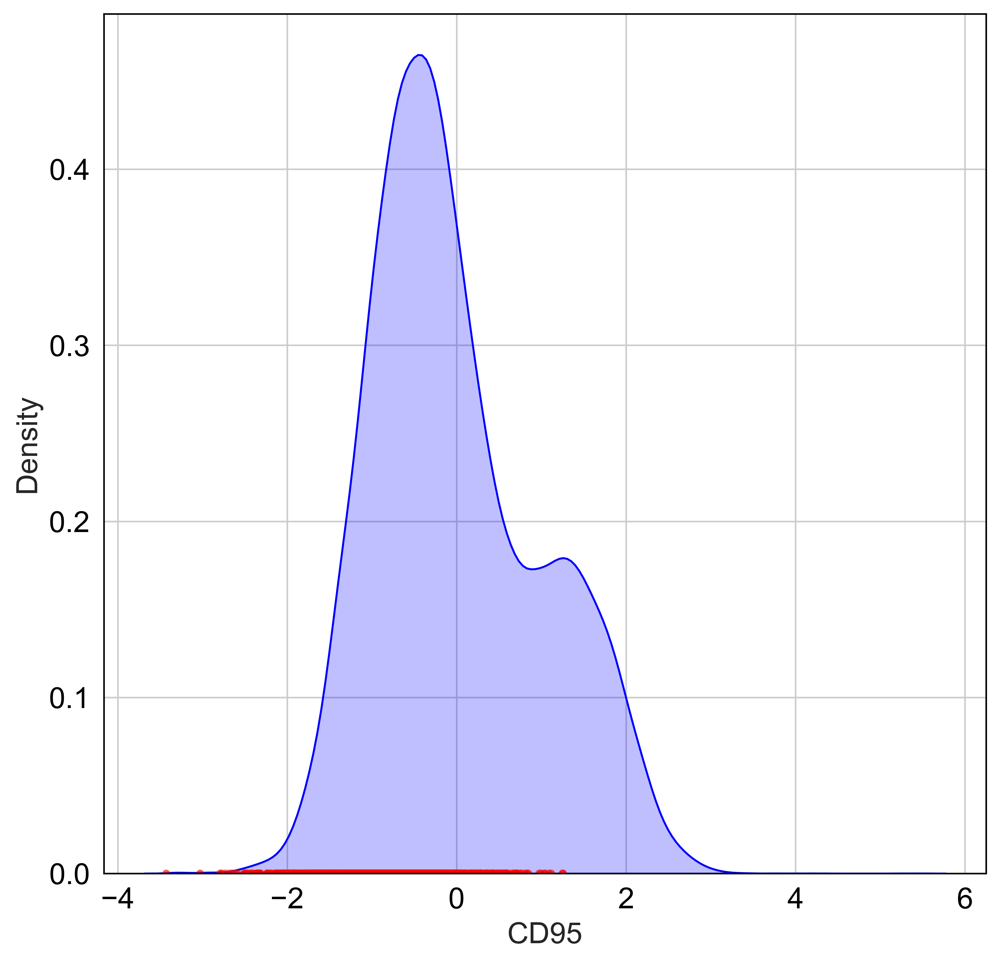

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


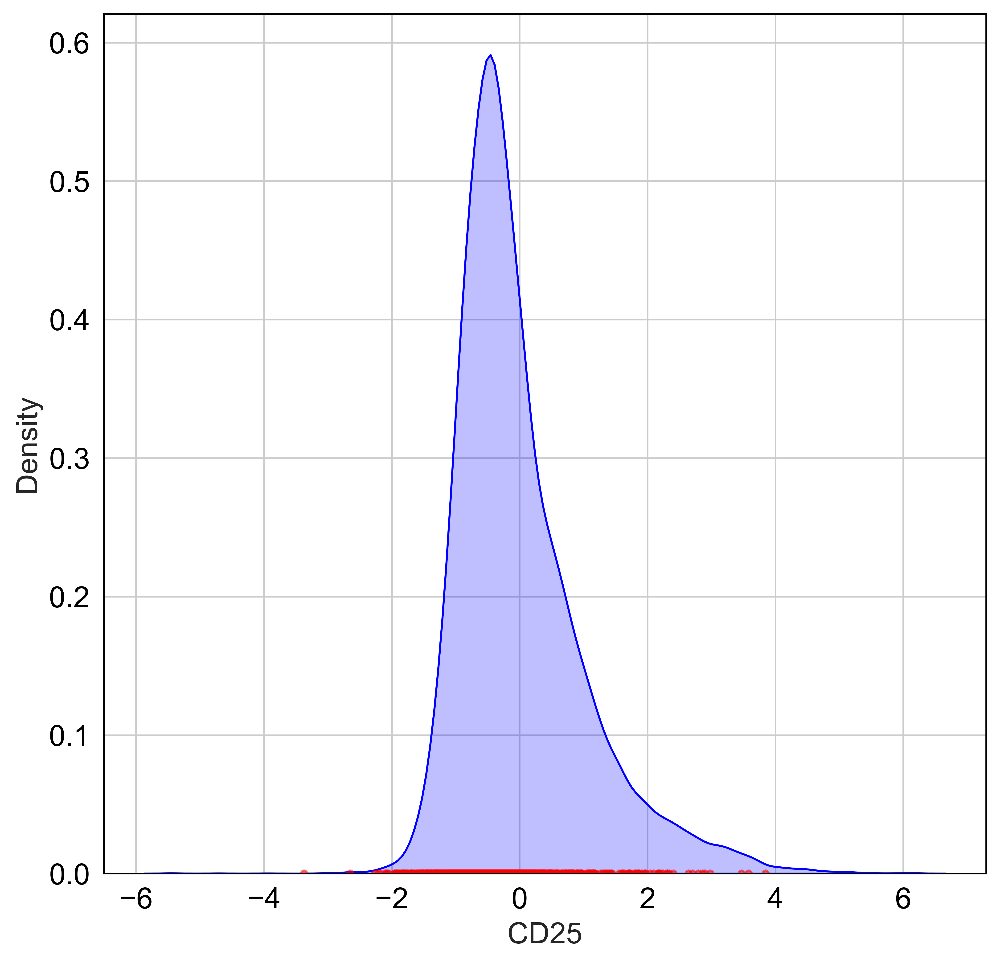

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


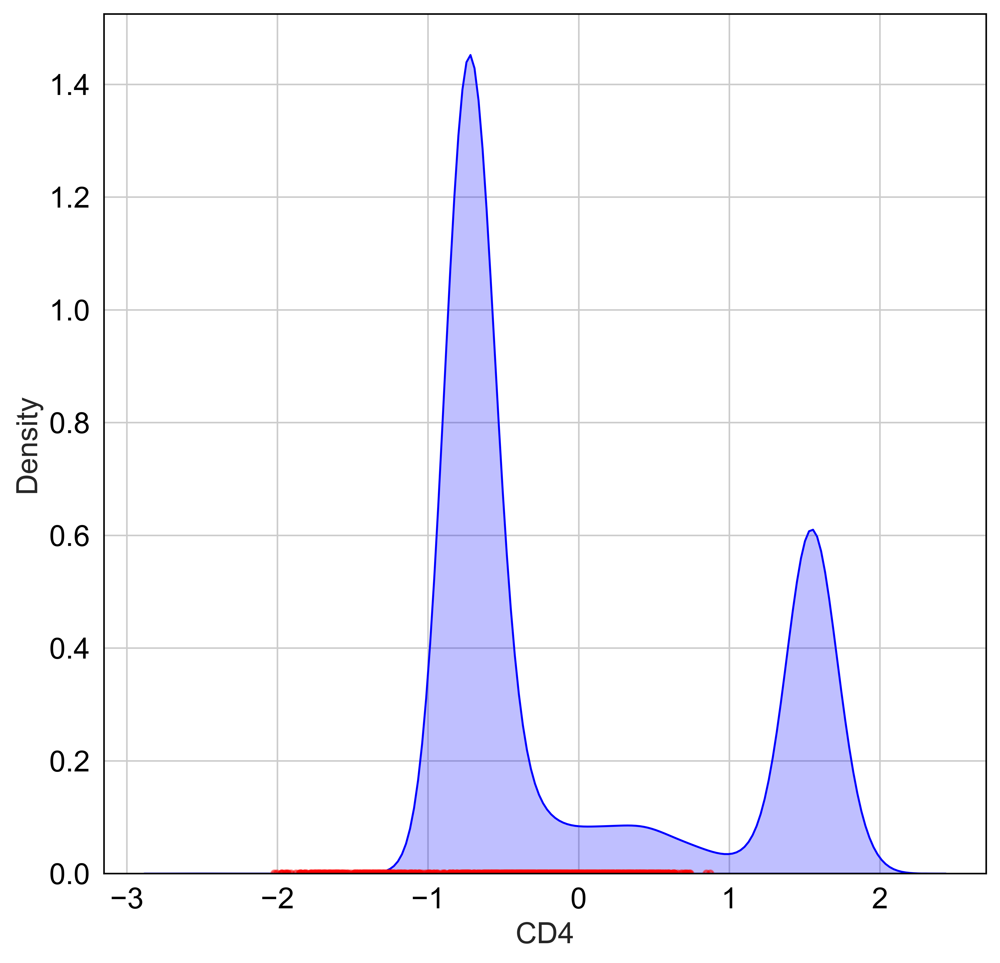

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


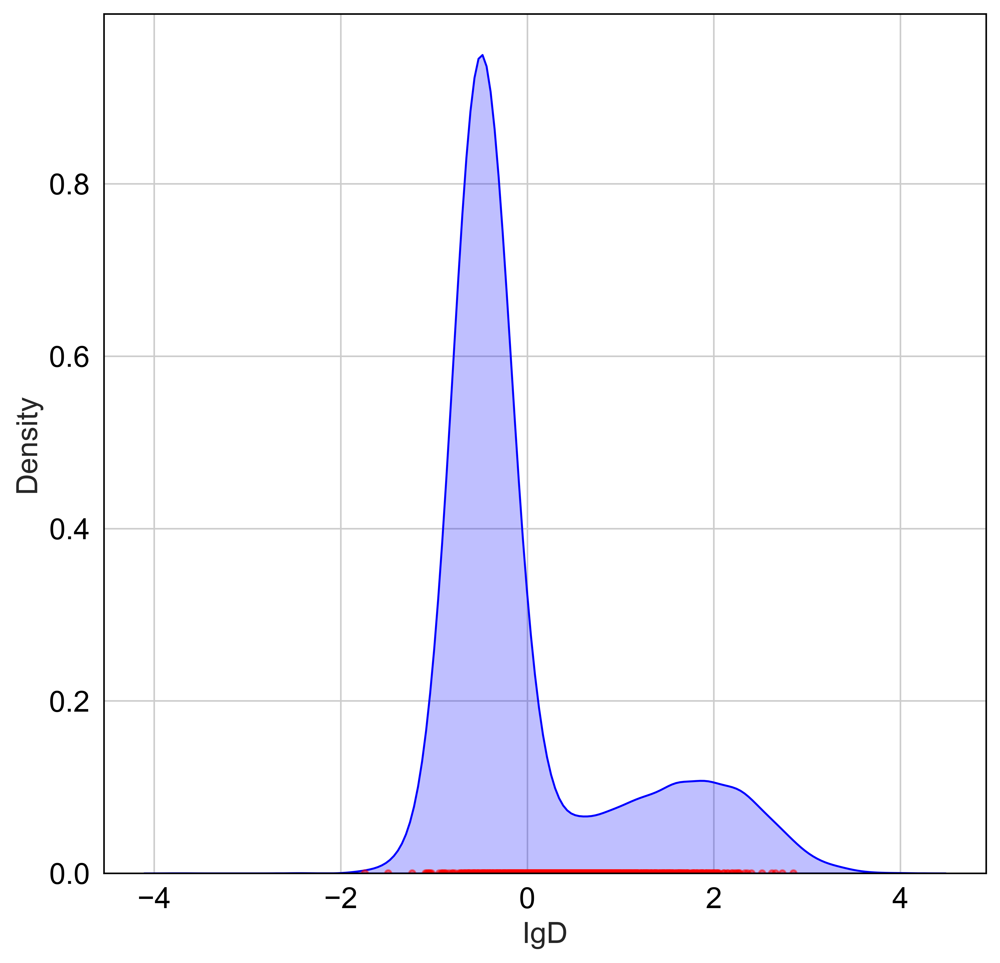

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


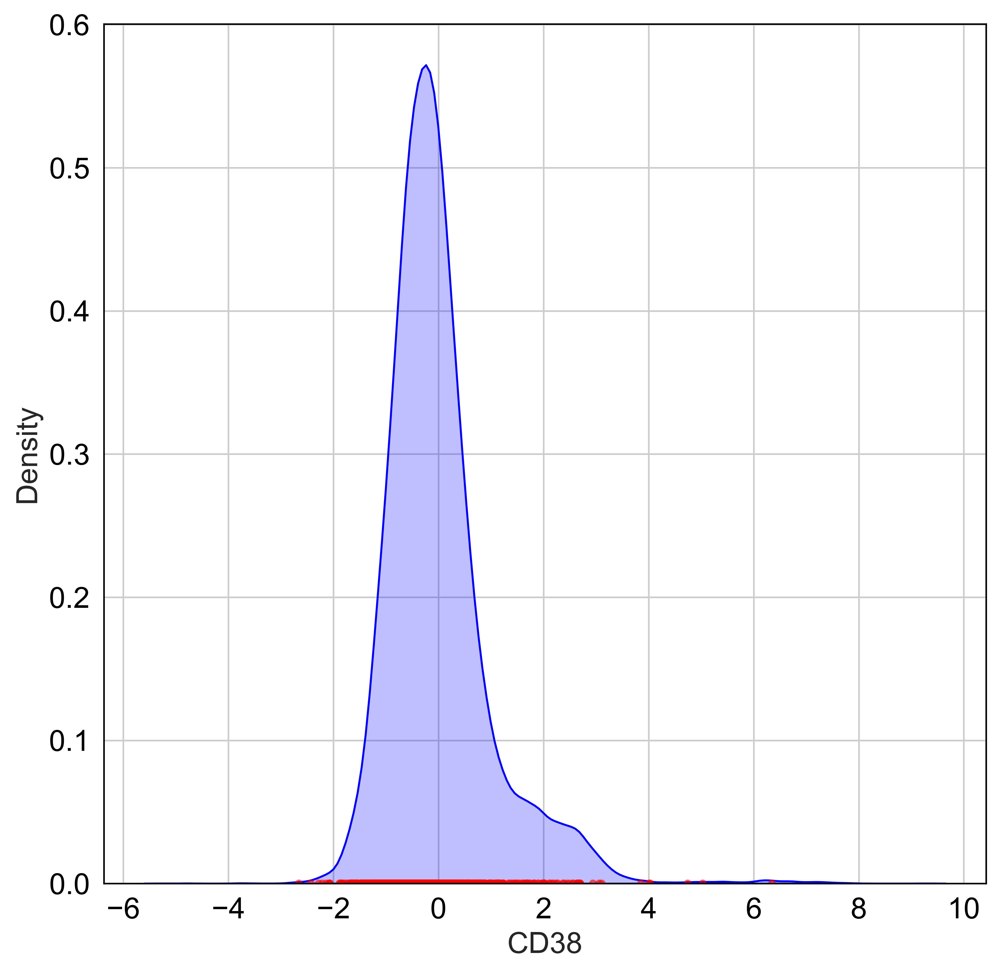

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


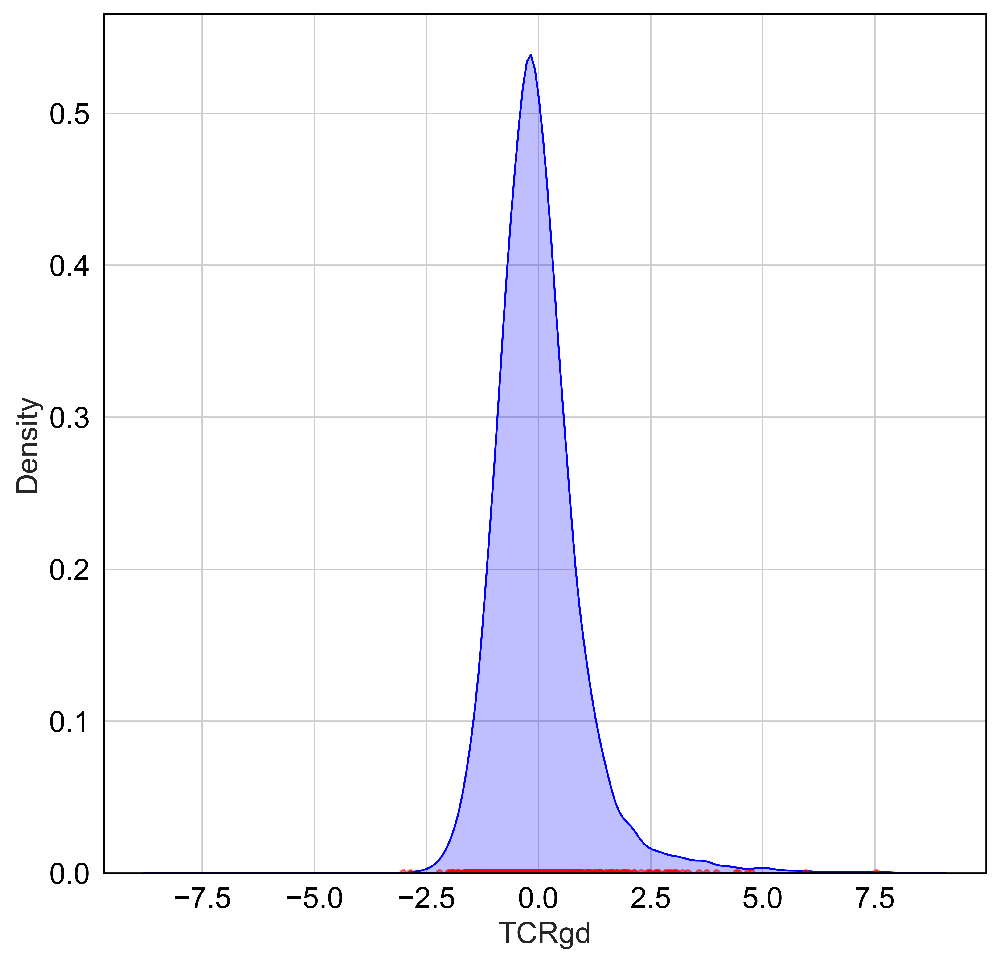

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


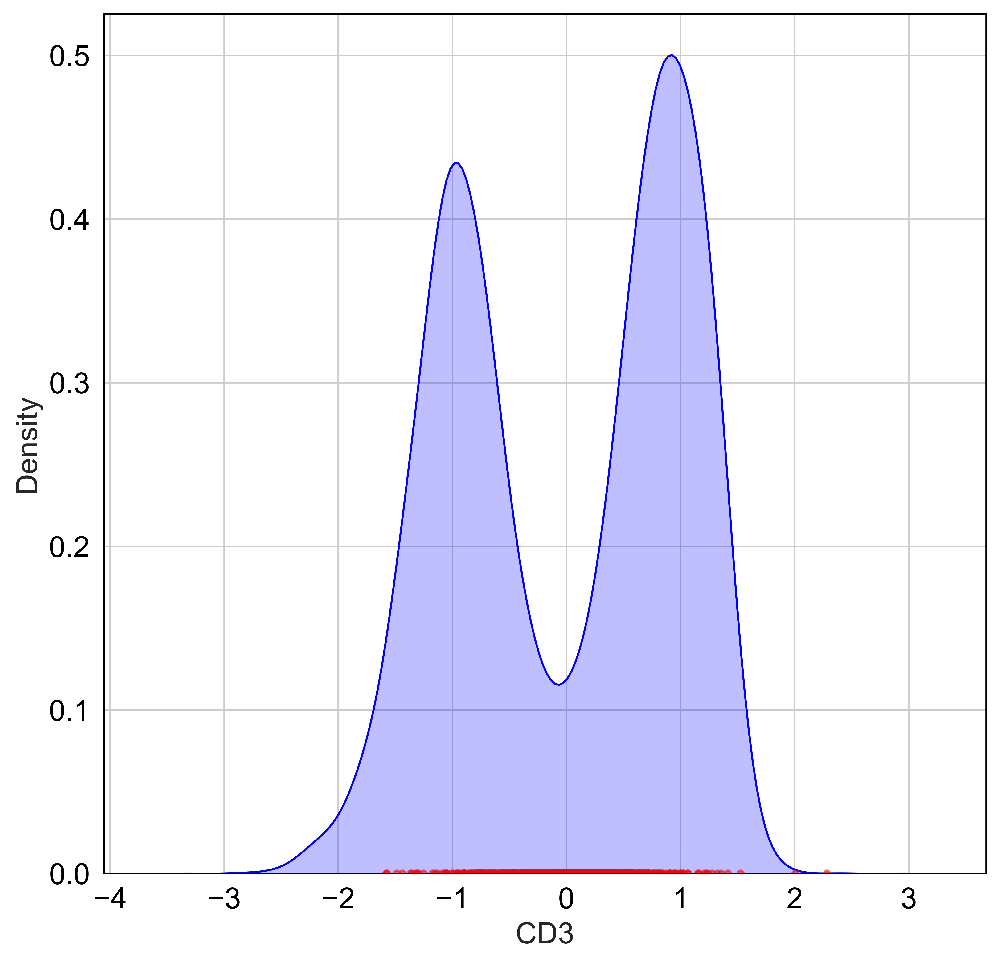

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


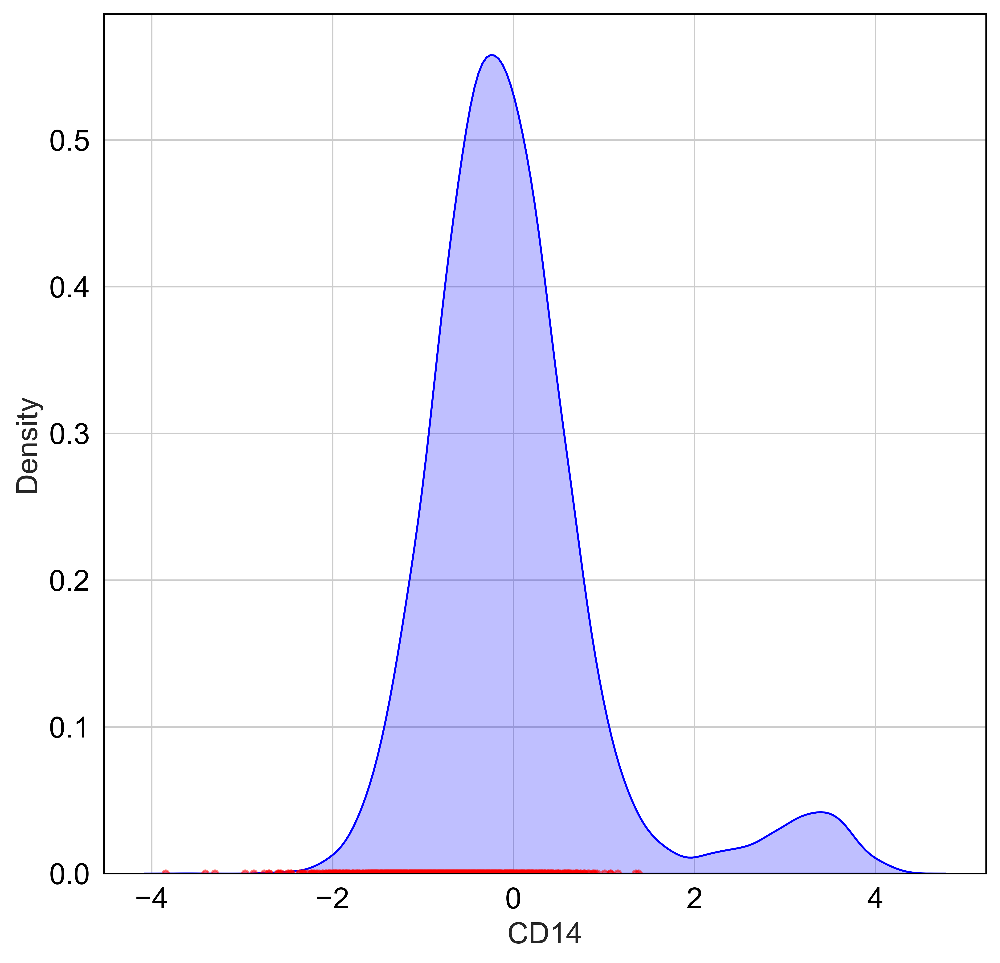

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/709735164.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


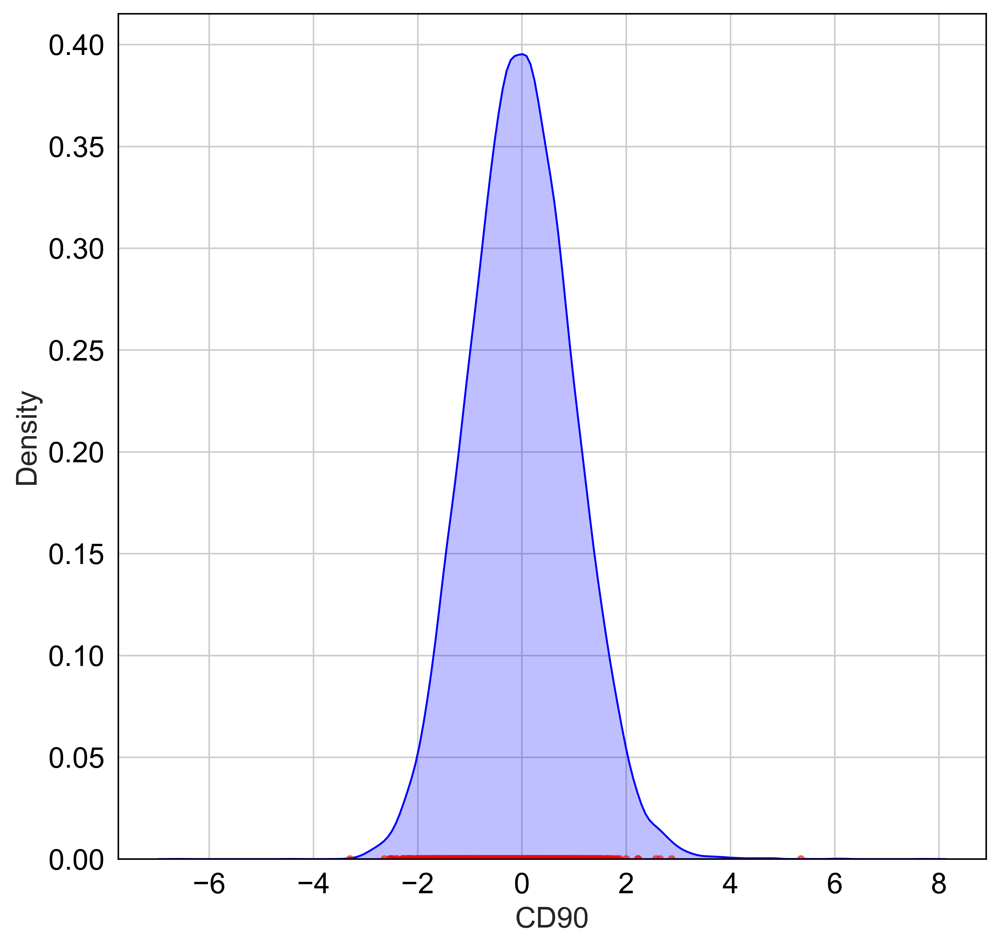

In [101]:
# Load the existing data
existing_data = adata.to_df()
# Convert high dim data to pandas DataFrame
simulation_data = adata_t1[adata.shape[0]:,].to_df()

for col in existing_data.columns:
    sns.kdeplot(existing_data[col], shade=True, color='blue')
    plt.scatter(simulation_data[col], np.zeros_like(simulation_data[col]), color='red', s=10, alpha=0.5)
    plt.xlabel(col)
    plt.show()

In [51]:
selected_genes = ['CD19', 'CD45', 'TCRab', 'CD3', 'CD90' ]

# selected_genes = ['SSC.A', 'CD94', 'CD19', 'TIM3', 'CD27', 'CD8', 
#  'CD39', 'CD45RO', 'CD11c', 'CD45RA', 'FcER1A', 'CD95', 'CD25', 'CD38', ]

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/1039159490.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


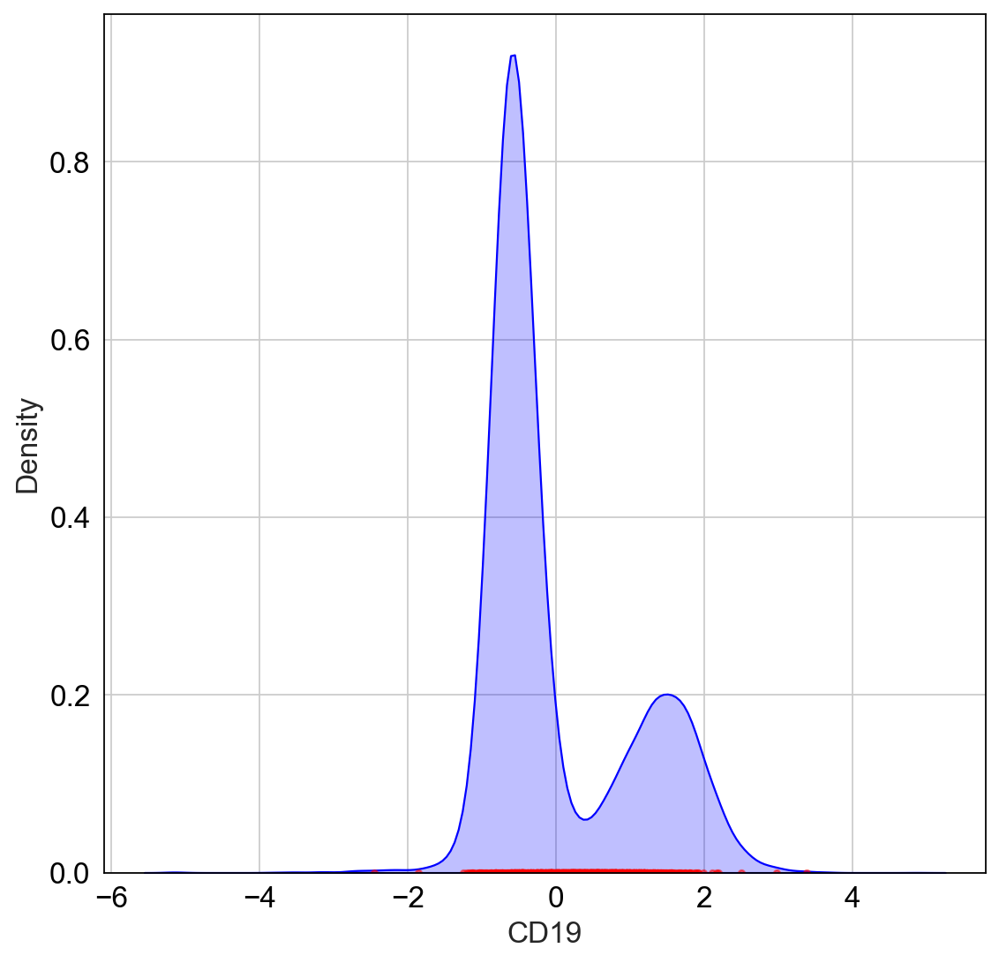

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/1039159490.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


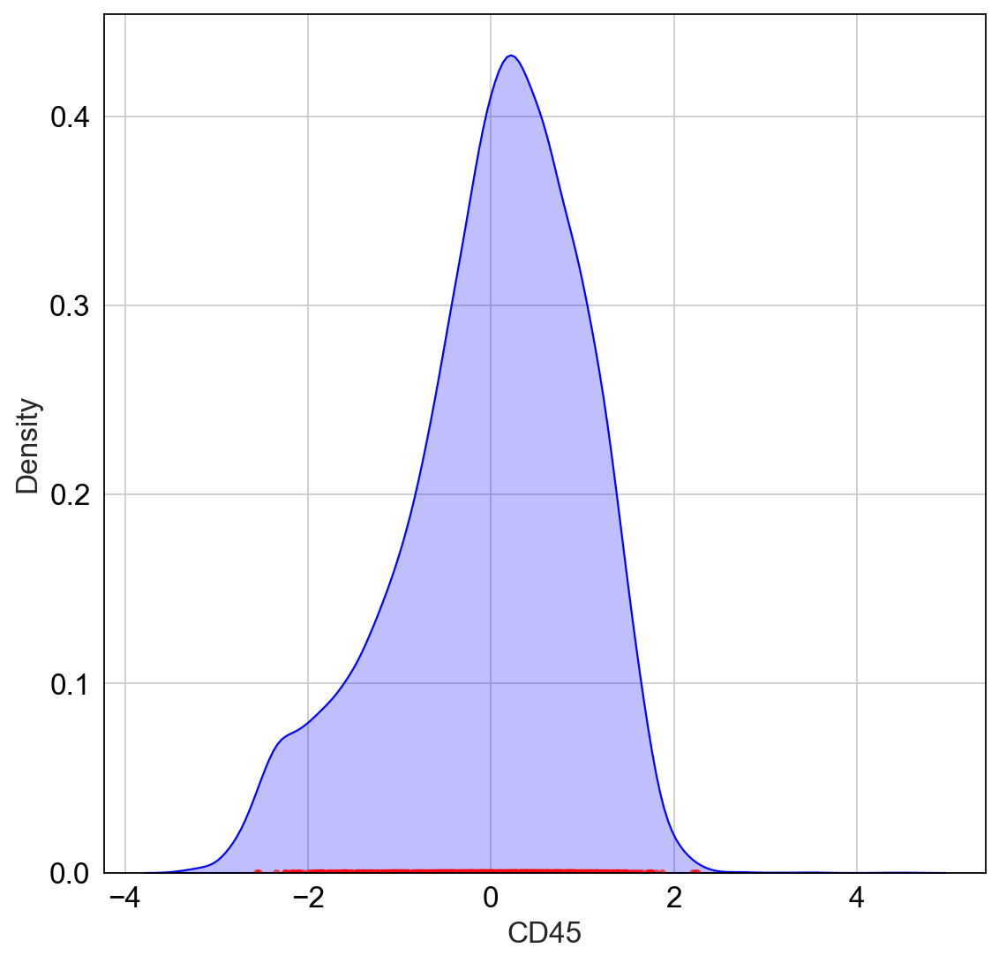

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/1039159490.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


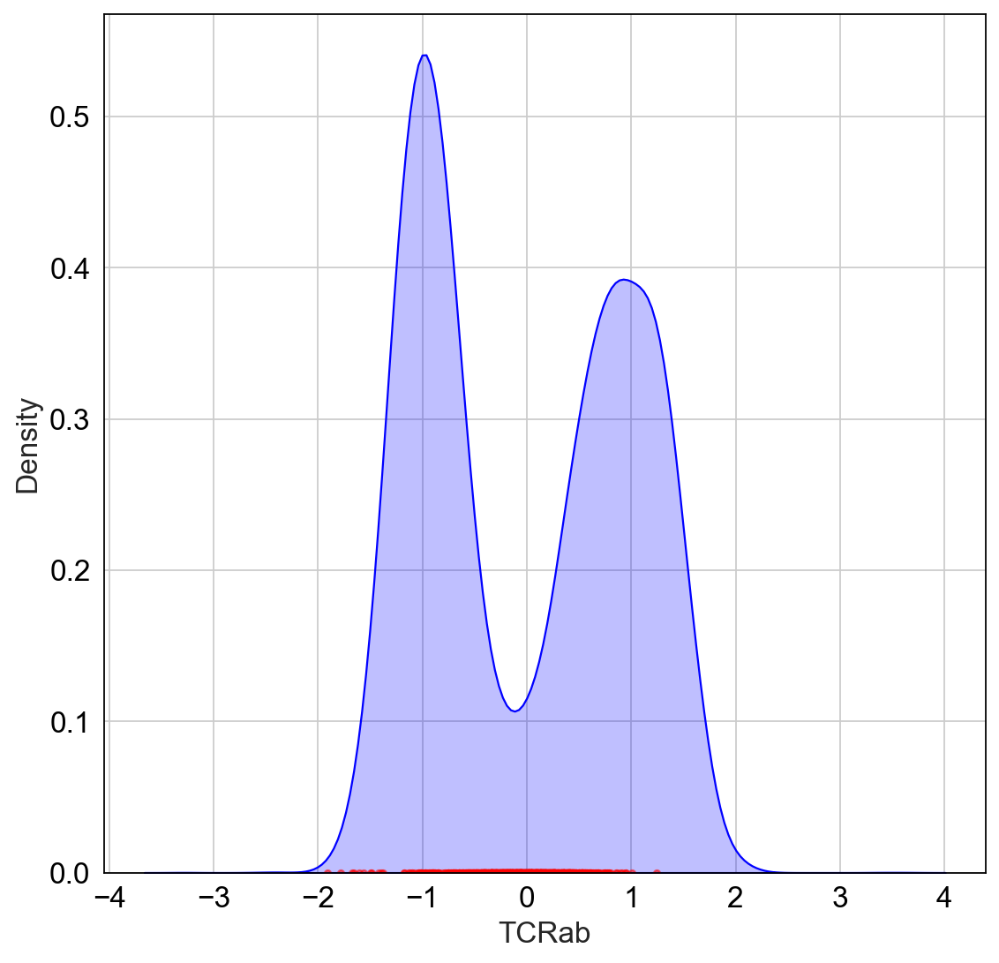

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/1039159490.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


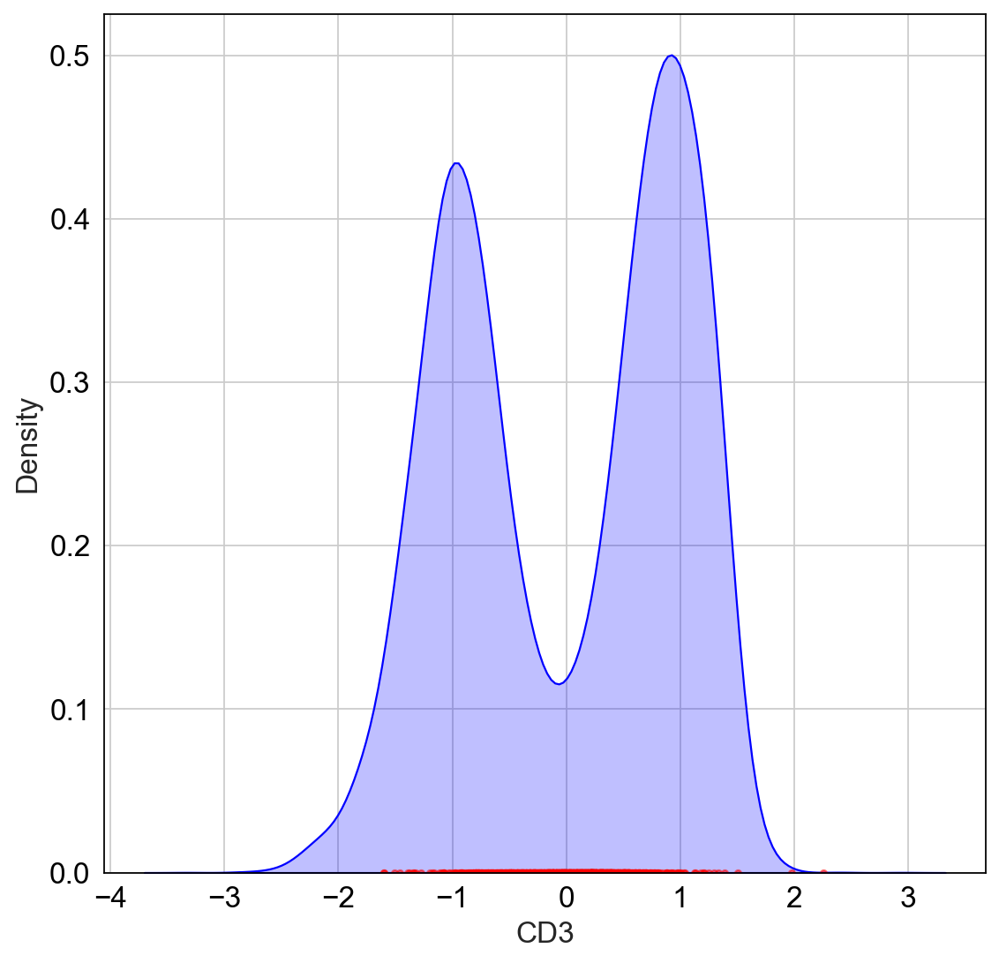

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/1039159490.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


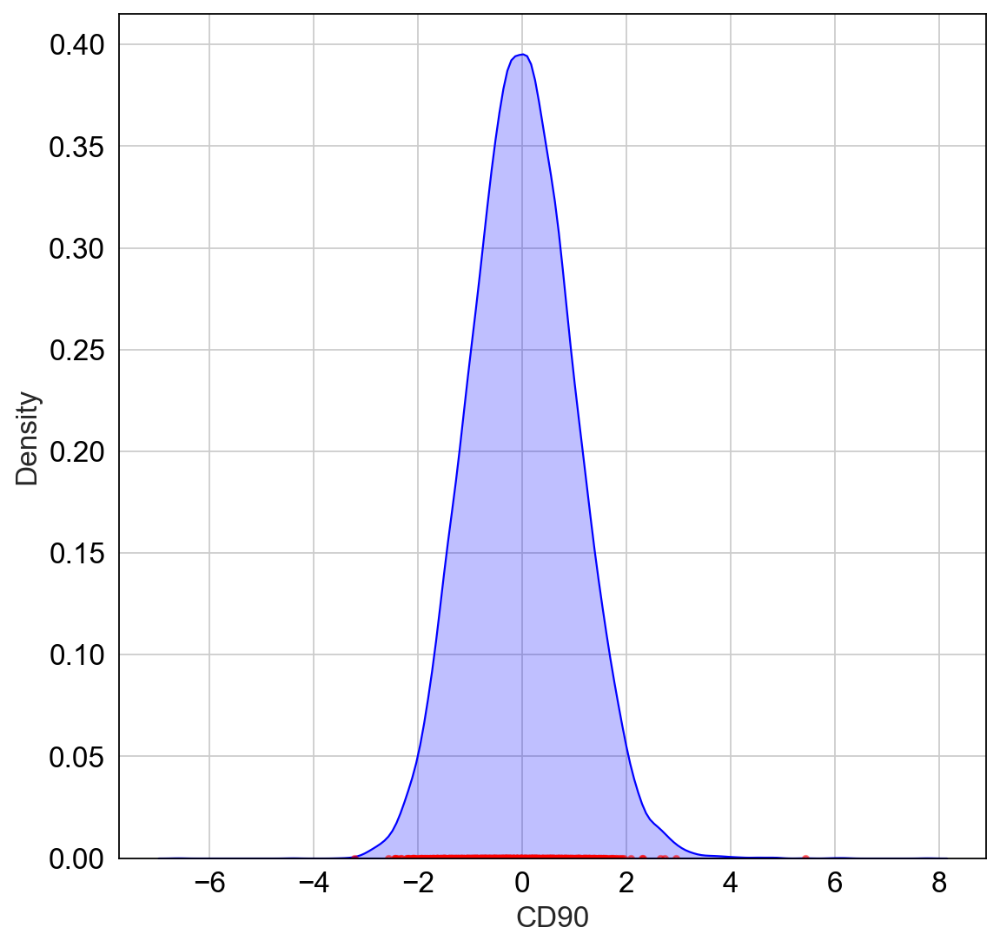

In [52]:
# Load the existing data
existing_data = adata[:, selected_genes].to_df()
# Convert high dim data to pandas DataFrame
simulation_data = simulation_data[selected_genes]

for col in existing_data.columns:
    sns.kdeplot(existing_data[col], shade=True, color='blue')
    plt.scatter(simulation_data[col], np.zeros_like(simulation_data[col]), color='red', s=10, alpha=0.5)
    plt.xlabel(col)
    plt.show()

In [53]:
cell_type_order = ext_adata.obs[label_key].value_counts().keys().values

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/3762039551.py:9: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue', ax=axs[i])
/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/3762039551.py:9: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue', ax=axs[i])
/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/3762039551.py:9: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue', ax=axs[i])
/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_12233/37620395

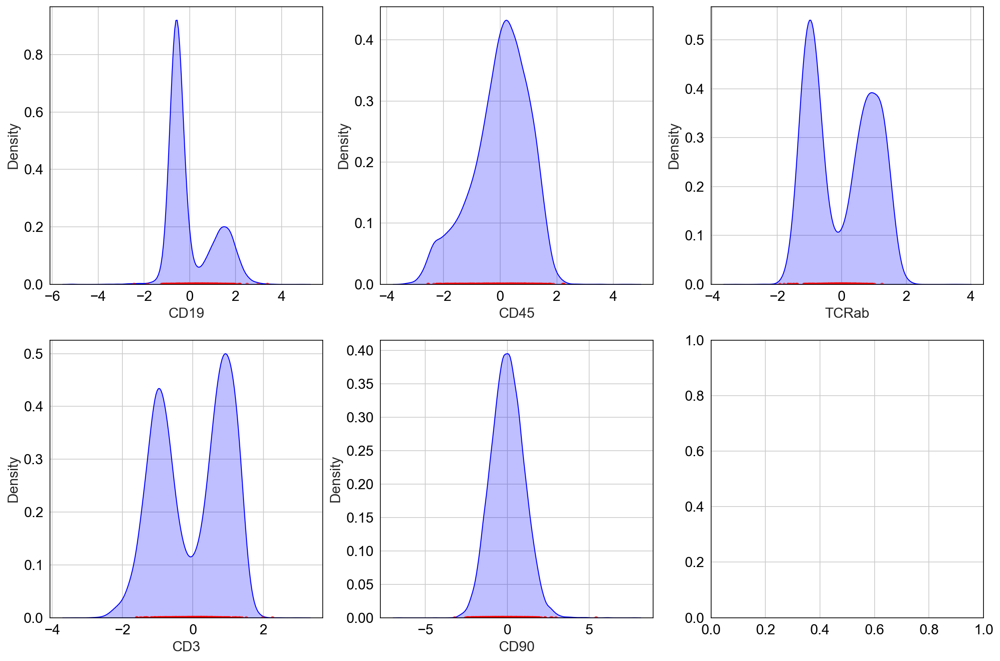

In [55]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

fig, axs = plt.subplots(nrows=2, ncols=3, figsize=(15,10))
axs = axs.ravel()

for i, col in enumerate(selected_genes):
    sns.kdeplot(existing_data[col], shade=True, color='blue', ax=axs[i])
    axs[i].scatter(simulation_data[col], np.zeros_like(simulation_data[col]), color='red', s=10, alpha=0.5)
#     plt.xlabel(col)
#     axs[i].set_title(col)


#     sns.kdeplot(data[feature], shade=True, ax=axs[i])
#     axs[i].set_title(feature)

plt.tight_layout()
plt.show()


### Take the artificial reference 

In [56]:
ref_adata = ext_adata[:, selected_genes]

In [64]:
corr_s = dist_sampling(ref_adata, sample_per_matrix= 15, rng= 45, seed = 125325)
corr_s.shape

(689,)

In [65]:
s_partially_s, _ = bin_sample(ref_adata, n_bins=14, s_size=19)
print(s_partially_s.size)
s_random_s = sample_random(ref_adata, s_size=s_partially_s.size)
# s_prop_s, tot = proportional_sampling(ref_adata, n_bins=16, total_size=189, power= 0.01, seed= 12345)

686


In [73]:
s_prop_s, tot = proportional_sampling(ref_adata, n_bins=16, total_size=185, power= 0.01, seed= 12345)
print(s_prop_s.size)

688


### Plots

In [74]:
sc.set_figure_params(dpi=300, color_map = 'viridis_r', figsize=(8,8), fontsize=15,)
sc.settings.verbosity = 1
sc.logging.print_header()
# sc.set_figure_params(figsize=(8,8), fontsize=15, )



scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.23.5 scipy==1.10.0 pandas==1.5.2 scikit-learn==1.2.0 statsmodels==0.13.5 python-igraph==0.9.11 pynndescent==0.5.8


In [81]:
small_random_adata = ref_adata[s_random_s]
change_cmap(small_random_adata, dictionary, celltype_key=label_key)


In [82]:
# sc.pl.umap(small_random_adata, color=['leiden', label_key], save= "uniform_schayan")

In [83]:
small_partially_adata = ref_adata[s_partially_s]
change_cmap(small_partially_adata, dictionary, celltype_key=label_key)


In [84]:
# sc.pl.umap(small_partially_adata, color=['leiden', label_key], save='FSBS_schayan')

In [85]:
small_prop_adata = ref_adata[s_prop_s]
change_cmap(small_prop_adata, dictionary,celltype_key=label_key)


In [86]:
# sc.pl.umap(small_prop_adata, color=['leiden', label_key], save="prop")

In [87]:
small_dist_adata = ref_adata[corr_s]
change_cmap(small_dist_adata, dictionary, celltype_key=label_key)


In [108]:
cell_type_order

['CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD16_NK', ..., 'GD_Tcells', 'CD16_Mono', 'CD56_NK', 'Plasma_cells', 'Doublets']
Length: 16
Categories (16, object): ['CD14_Mono', 'CD16_Mono', 'CD16_NK', 'CD4_Tcells', ..., 'Late_Bcells', 'Myeloid_progenitors', 'Plasma_cells', 'Sim']

In [93]:
small_random_adata.obs['batch'] = 'Random'
small_partially_adata.obs['batch'] = 'Bin-sampling'
small_dist_adata.obs['batch'] = 'dist-sampling'

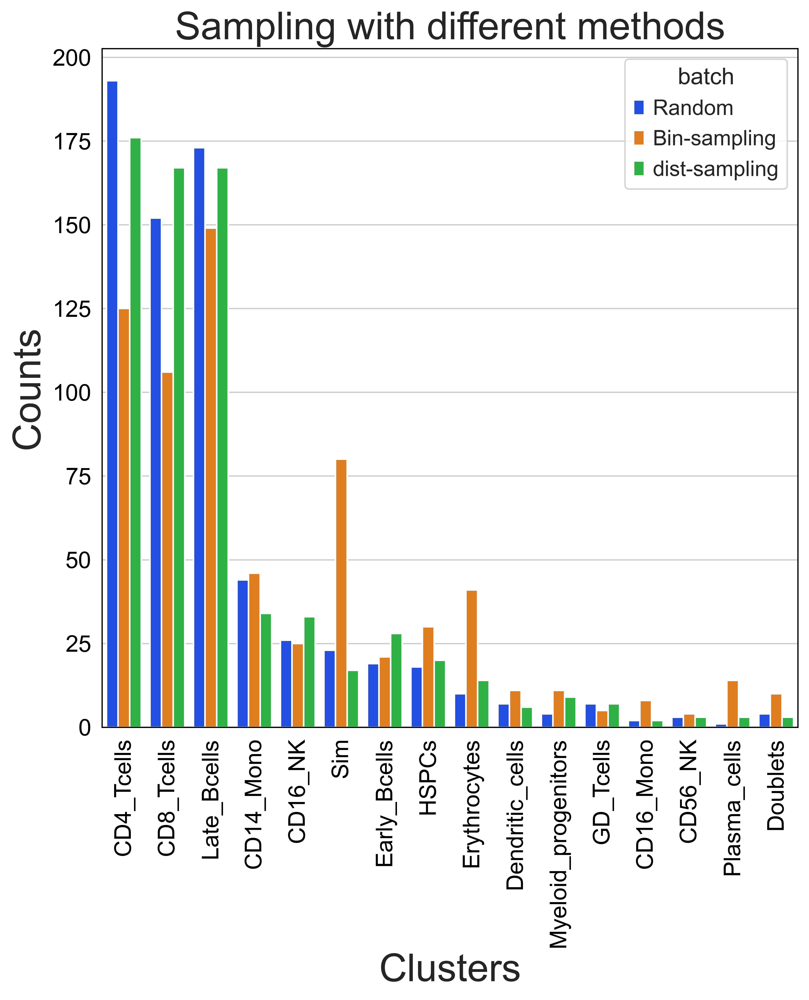

In [94]:
df_mixed = pd.concat([small_random_adata.obs, small_partially_adata.obs, small_dist_adata.obs])
g2 = sns.countplot(data=df_mixed, x="labels", hue="batch", palette="bright", order=cell_type_order)
plt.xticks(rotation=90)
plt.ylabel("Counts", size = 25)
plt.xlabel("Clusters", size = 25)
plt.title("Sampling with different methods", size= 25)
plt.savefig("all_methods_sim.png", dpi=200, bbox_inches='tight', pad_inches = 0.5)

In [151]:
# sc.pl.umap(small_corr_adata, color=['leiden', label_key], save="CORR_schayan")

In [79]:
ref_adata

AnnData object with n_obs × n_vars = 31000 × 5
    obs: 'level_0', 'labels'
    uns: 'pca', 'neighbors', 'umap', 'labels_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

### Bootstraping

In [154]:
from FACS_Sampling.methods.analysis import bootstrap

In [155]:
df = bootstrap(ref_adata, rep=40)

In [156]:
l = df[label_key].unique()

In [157]:
df['method'].unique()

array(['Random', 'FSBS', 'Proportional'], dtype=object)

In [158]:
m1 = df[df['method'].isin(['Random'])]
m2 = df[df['method'].isin(['FSBS'])]
m3 = df[df['method'].isin(['Proportional'])]

In [159]:
sns.set(font_scale=1.5)


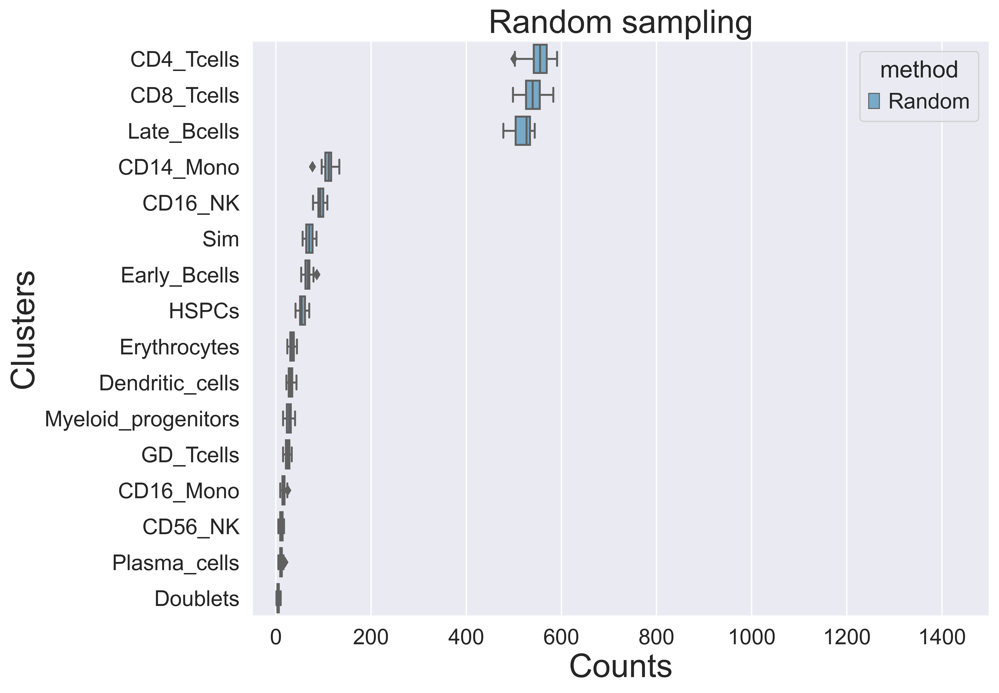

In [160]:
plt.figure(figsize=(10, 8))
g = sns.boxplot(y=label_key, x="count", hue='method',data=m1, orient='h', order= cell_type_order, palette="Blues")
plt.xlim(-50, 1500)
# plt.xticks(rotation=90)
plt.ylabel("Clusters", size = 25)
plt.xlabel("Counts", size = 25)
plt.title("Random sampling", size= 25)
plt.savefig("Random.png", dpi=200, bbox_inches='tight', pad_inches = 0.5)

In [161]:
# m2['method'] = "Fixed_size_bin_sampling"

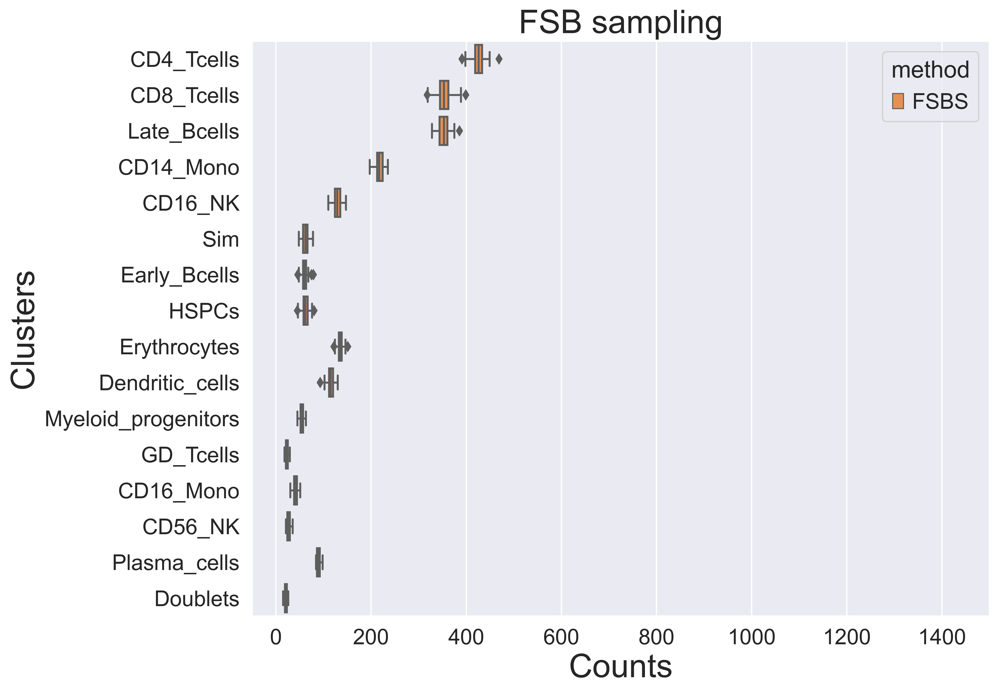

In [162]:
plt.figure(figsize=(10, 8))
g = sns.boxplot(y=label_key, x="count", hue='method',data=m2, orient='h', order= cell_type_order, palette='Oranges')
plt.xlim(-50, 1500)
# plt.xticks(rotation=90)
plt.ylabel("Clusters", size = 25)
plt.xlabel("Counts", size = 25)
plt.title("FSB sampling",  size= 25)
plt.savefig("Fixed_size_bin_sampling.png", dpi=200, bbox_inches='tight', pad_inches = 0.5)

In [163]:
# m3['batch'] = "Proportional_per_bin_counts"

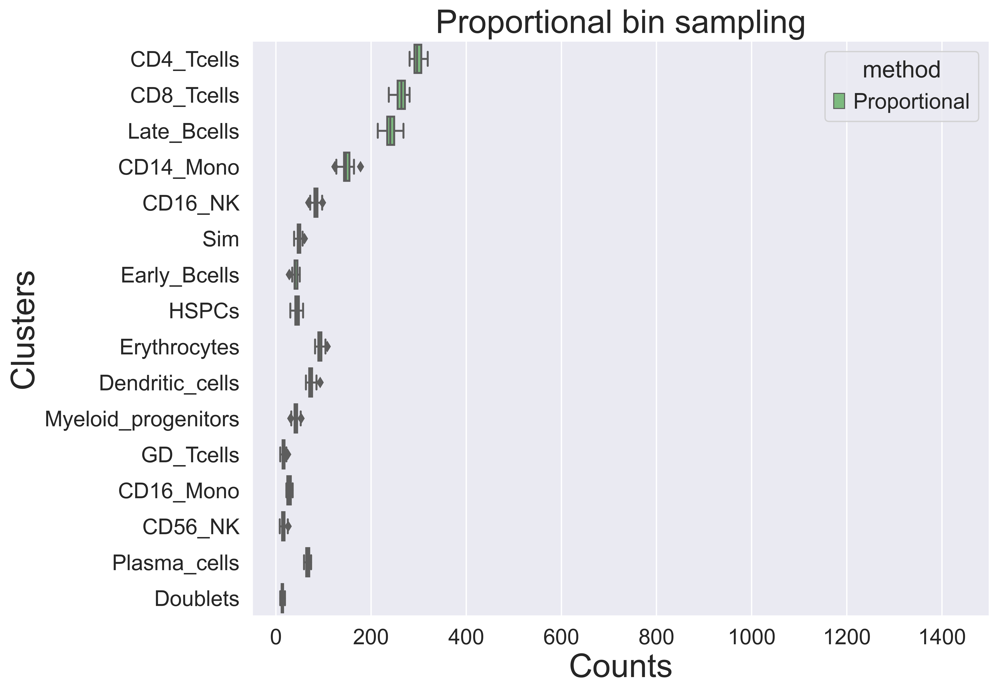

In [164]:
plt.figure(figsize=(10, 8))
g = sns.boxplot(y=label_key, x="count", hue='method',data=m3, orient='h', order= cell_type_order, palette="Greens")
plt.xlim(-50, 1500)
# plt.xticks(rotation=90)
plt.ylabel("Clusters", size = 25)
plt.xlabel("Counts", size = 25)
plt.title("Proportional bin sampling",  size= 25)
plt.savefig("Proportional_per_bin_counts.png", dpi=200, bbox_inches='tight', pad_inches = 0.5)

### Check the MNN

In [189]:
from scipy.spatial import cKDTree

def find_mutual_nn(data1, data2, k1, k2):
    # we consider data1 as train data (sampled data) and data2 as test data (whole data)
    k_index_1 = cKDTree(data1).query(x=data2, k=k1)[1]
    k_index_2 = cKDTree(data2).query(x=data1, k=k2)[1]
    mutual_1 = []
    mutual_2 = []
    for index_2 in range(data2.shape[0]):
        for index_1 in k_index_1[index_2]:
            if index_2 in k_index_2[index_1]:
                mutual_1.append(index_1)
                mutual_2.append(index_2)

    return mutual_1, mutual_2

def clean(mutual_1, mutual_2, train_labels):
    dictionary = dict()
    for i in range(len(mutual_2)):
        if mutual_2[i] not in dictionary.keys():
            dictionary[mutual_2[i]] = [train_labels[mutual_1[i]]]
        else:
            dictionary[mutual_2[i]].append(train_labels[mutual_1[i]])

    return dictionary


In [193]:
def get_mnn_classification_report(index_subset, ref_adata, label_key='labels'):
    small_adata = ref_adata[index_subset]
    bad_inds = small_adata.obs.index
    bad_df = ref_adata.obs.index.isin(bad_inds)

    X_train = small_adata.X
    y_train = small_adata.obs[label_key]
    X_test = ref_adata[~bad_df].X
    y_test = ref_adata[~bad_df].obs[label_key]

    y_pred = MNN_classifier(X_train, X_test, y_train, k=100)

    cr = classification_report(y_test, y_pred, output_dict=True)
    df_cr = pd.DataFrame(cr)
    return df_cr

def MNN_classifier(train_data, test_data, train_labels, k=100):
    mutual_1, mutual_2 = find_mutual_nn(train_data, test_data, k1=k, k2=k)
    dictionary = clean(mutual_1, mutual_2, train_labels)
    y_pred = []
    not_found = []

    clf = neighbors.KNeighborsClassifier(n_neighbors=5)
    clf.fit(train_data, train_labels)

    for i in range(test_data.shape[0]):
        if i in dictionary.keys():
            label = max(set(dictionary[i]), key=dictionary[i].count)
        else:
            label = clf.predict(test_data[i].reshape(1, -1))[0]
            not_found.append(i)
        y_pred.append(label)
    print("{} cells could not get MNN's in the other datasets.".format(len(not_found)))

    return y_pred

In [197]:
print(get_mnn_classification_report(s_random_s, ref_adata))

1345 cells could not get MNN's in the other datasets.
             CD14_Mono   CD16_Mono      CD16_NK   CD4_Tcells     CD56_NK  \
precision     0.881854    0.730769     0.848228     0.954198    0.415929   
recall        0.908541    0.535211     0.871044     0.975249    0.281437   
f1-score      0.894998    0.617886     0.859485     0.964609    0.335714   
support    1487.000000  213.000000  1264.000000  7434.000000  167.000000   

            CD8_Tcells  Dendritic_cells   Doublets  Early_Bcells  \
precision     0.954721         0.838428   0.500000      0.765756   
recall        0.964978         0.929782   0.818182      0.836009   
f1-score      0.959822         0.881745   0.620690      0.799342   
support    7167.000000       413.000000  55.000000    872.000000   

           Erythrocytes   GD_Tcells       HSPCs  Late_Bcells  \
precision      0.768150    0.330435    0.607370     0.985704   
recall         0.743764    0.121406    0.694767     0.963464   
f1-score       0.755760    0.177

In [196]:
# big_data, small_data, k1, k2 = adata[ps].X, adata[rs].X, 200, 200
# get_mnn_classification_report(index_subset, ref_adata, label_key='labels'):

train_data=adata[ps].X
test_data=adata[rs].X
train_labels=adata[ps].obs[label_key]
k=100

mutual_1, mutual_2 = find_mutual_nn(train_data, test_data, k1=k, k2=k)

In [241]:
y_pred = MNN_classifier(train_data, test_data, train_labels, k)

7 cells could not get MNN's in the other datasets.


In [232]:
test_labels=adata[rs].obs[label_key]

lis = ['"Late_Bcells"', '"CD8_Tcells"', '"Late_Bcells"',
       '"CD4_Tcells"', '"CD4_Tcells"', '"HSPCs"', '"Late_Bcells"',
       '"Late_Bcells"', '"CD16_NK"', '"CD8_Tcells"', '"CD8_Tcells"']

In [243]:
print(classification_report(test_labels, y_pred))

                       precision    recall  f1-score   support

          "CD14_Mono"       0.98      0.98      0.98       299
          "CD16_Mono"       0.97      0.90      0.93        39
            "CD16_NK"       0.95      0.99      0.97       215
         "CD4_Tcells"       1.00      0.99      1.00      1407
            "CD56_NK"       0.94      0.88      0.91        34
         "CD8_Tcells"       1.00      0.99      0.99      1352
    "Dendritic_cells"       0.99      0.94      0.96        85
           "Doublets"       0.78      0.88      0.82         8
       "Early_Bcells"       0.99      0.93      0.96       154
       "Erythrocytes"       0.97      0.99      0.98        88
          "GD_Tcells"       0.88      0.97      0.92        60
              "HSPCs"       0.89      0.99      0.93       137
        "Late_Bcells"       1.00      1.00      1.00      1308
"Myeloid_progenitors"       0.82      0.85      0.83        62
       "Plasma_cells"       0.89      1.00      0.94  

In [197]:
dictionary = clean(mutual_1, mutual_2, train_labels)

In [214]:
y_pred =[]
not_found = []

clf = neighbors.KNeighborsClassifier(n_neighbors=5)
clf.fit(train_data, train_labels)

for i in range(test_data.shape[0]):
    if i in dictionary.keys():
        label = max(set(dictionary[i]), key=dictionary[i].count)
    else:
        label = clf.predict(test_data[i].reshape(1,-1))
        not_found.append(i)
    y_pred.append(label)

### KNN for label transfer

In [171]:
from sklearn import neighbors
from sklearn.metrics import classification_report

def training(index_subset, ref_adata, label_key='labels'):
    small_adata = ref_adata[index_subset]
    bad_inds = small_adata.obs.index
    bad_df = ref_adata.obs.index.isin(bad_inds)
    
    X_train = small_adata.X
    y_train = small_adata.obs[label_key]
    X_test = ref_adata[~bad_df].X
    y_test = ref_adata[~bad_df].obs[label_key]

    clf = neighbors.KNeighborsClassifier(n_neighbors=5)
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)


    cr = classification_report(y_test, y_pred, output_dict=True)
    df_cr = pd.DataFrame(cr)
    return df_cr

In [172]:
def repeat_knn(ref_adata, label_key='labels', rep = 5, seed=12345):
    np.random.seed(seed)
    output_random = []
    output_fsbs = []
    output_pbs = []
    
    groupped_df = pd.DataFrame(data=None, columns=["count", label_key, "method"])
    for i in range(rep):
        new_seed = np.random.randint(10675)
        
        ps,_ = bin_sample(ref_adata, n_bins=14, s_size=20, seed=new_seed)
        rs = sample_random(ref_adata, s_size=ps.size, seed=new_seed)
        prop_s, _ = proportional_sampling(ref_adata, n_bins=14, total_size=150, power= 0.01, seed= new_seed)
        
        output_random.append(training(rs, ref_adata))
        output_fsbs.append(training(ps, ref_adata))
        output_pbs.append(training(prop_s, ref_adata))
    return output_random, output_fsbs, output_pbs

In [173]:
output_random, output_fsbs, output_pbs = repeat_knn(ref_adata)

In [174]:
acc_rand = []
acc_fsbs = []
acc_pbs = []
for i in range(5):
    acc_rand.append(output_random[i]['accuracy'][0])
    acc_fsbs.append(output_fsbs[i]['accuracy'][0])
    acc_pbs.append(output_pbs[i]['accuracy'][0])

In [175]:
new_seed = np.random.randint(10675)

ps,_ = bin_sample(ref_adata, n_bins=14, s_size=20, seed=new_seed)
rs = sample_random(ref_adata, s_size=ps.size, seed=new_seed)
prop_s, _ = proportional_sampling(ref_adata, n_bins=14, total_size=150, power= 0.01, seed= new_seed)

In [176]:
training(rs, ref_adata)

,CD14_Mono,CD16_Mono,CD16_NK,CD4_Tcells,CD56_NK,CD8_Tcells,Dendritic_cells,Doublets,Early_Bcells,Erythrocytes,GD_Tcells,HSPCs,Late_Bcells,Myeloid_progenitors,Plasma_cells,Sim,accuracy,macro avg,weighted avg
precision,0.833617,0.852113,0.827214,0.940885,0.586207,0.975124,0.944882,1.000000,0.716696,0.944079,0.625000,0.731855,0.978821,0.645740,0.990826,0.959016,0.931385,0.847005,0.927691
recall,0.985235,0.593137,0.930364,0.995570,0.209877,0.955299,0.867470,0.166667,0.944965,0.655251,0.016287,0.515625,0.984067,0.395604,0.782609,1.000000,0.931385,0.687377,0.931385
f1-score,0.903107,0.699422,0.875762,0.967456,0.309091,0.965110,0.904523,0.285714,0.815152,0.773585,0.031746,0.605000,0.981437,0.490630,0.874494,0.979079,0.931385,0.716332,0.922704
support,1490.000000,204.000000,1235.000000,7450.000000,162.000000,7181.000000,415.000000,60.000000,854.000000,438.000000,307.000000,704.000000,6904.000000,364.000000,138.000000,936.000000,0.931385,28842.000000,28842.000000


In [177]:
training(ps, ref_adata)

,CD14_Mono,CD16_Mono,CD16_NK,CD4_Tcells,CD56_NK,CD8_Tcells,Dendritic_cells,Doublets,Early_Bcells,Erythrocytes,GD_Tcells,HSPCs,Late_Bcells,Myeloid_progenitors,Plasma_cells,Sim,accuracy,macro avg,weighted avg
precision,0.883464,0.897638,0.824574,0.950422,0.511364,0.972337,0.938838,0.875000,0.760075,0.796512,0.571429,0.807512,0.981979,0.819149,1.000000,0.955511,0.940815,0.846613,0.936217
recall,0.975557,0.626374,0.935348,0.992640,0.304054,0.963716,0.905605,0.500000,0.935409,0.827795,0.012987,0.494964,0.987401,0.455621,0.852459,1.000000,0.940815,0.735621,0.940815
f1-score,0.927229,0.737864,0.876475,0.971072,0.381356,0.968007,0.921922,0.636364,0.838676,0.811852,0.025397,0.613738,0.984683,0.585551,0.920354,0.977249,0.940815,0.761112,0.933104
support,1391.000000,182.000000,1191.000000,7609.000000,148.000000,7331.000000,339.000000,42.000000,867.000000,331.000000,308.000000,695.000000,7064.000000,338.000000,61.000000,945.000000,0.940815,28842.000000,28842.000000


In [181]:

small_partially_adata = ref_adata[s_partially_s]
change_cmap(small_partially_adata, dictionary)


In [182]:
bad_inds1 = small_partially_adata.obs.index
bad_inds2 = small_random_adata.obs.index
bad_inds3 = small_prop_adata.obs.index


bad_inds = np.concatenate((bad_inds1, bad_inds2, bad_inds3))

In [183]:
bad_df1 = ref_adata.obs.index.isin(bad_inds1)
bad_df2 = ref_adata.obs.index.isin(bad_inds2)
bad_df3 = ref_adata.obs.index.isin(bad_inds3)

In [184]:
df_cr = training(s_partially_s, ref_adata)

In [185]:
df_cr['accuracy']

precision    0.939276
recall       0.939276
f1-score     0.939276
support      0.939276
Name: accuracy, dtype: float64

In [186]:
X_train1 = small_partially_adata.X
y_train1 = small_partially_adata.obs['labels']
X_test1 = ref_adata[~bad_df1].X
y_test1 = ref_adata[~bad_df1].obs['labels']

clf = neighbors.KNeighborsClassifier(n_neighbors=5)
clf.fit(X_train1, y_train1)
y_pred1 = clf.predict(X_test1)

from sklearn.metrics import classification_report

cr1 = classification_report(y_test1, y_pred1, output_dict=True)
df_cr1 = pd.DataFrame(cr1).transpose()
print(classification_report(y_test1, y_pred1))

                     precision    recall  f1-score   support

          CD14_Mono       0.88      0.98      0.93      1375
          CD16_Mono       0.94      0.60      0.73       178
            CD16_NK       0.83      0.94      0.88      1202
         CD4_Tcells       0.94      1.00      0.97      7593
            CD56_NK       0.60      0.32      0.42       151
         CD8_Tcells       0.97      0.96      0.97      7343
    Dendritic_cells       0.95      0.88      0.91       338
           Doublets       0.88      0.34      0.49        44
       Early_Bcells       0.77      0.92      0.84       870
       Erythrocytes       0.84      0.75      0.79       325
          GD_Tcells       0.89      0.03      0.05       312
              HSPCs       0.84      0.48      0.61       700
        Late_Bcells       0.98      0.99      0.98      7061
Myeloid_progenitors       0.67      0.51      0.58       334
       Plasma_cells       1.00      0.90      0.95        60
                Sim    

In [60]:
df_cr1.sort_values('support').transpose()['accuracy'][0]

0.919666451347701

In [187]:
X_train2 = small_random_adata.X
y_train2 = small_random_adata.obs['labels']
X_test2 = ref_adata[~bad_df2].X
y_test2 = ref_adata[~bad_df2].obs['labels']

clf = neighbors.KNeighborsClassifier(n_neighbors=5)
clf.fit(X_train2, y_train2)
y_pred2 = clf.predict(X_test2)

from sklearn.metrics import classification_report
print(classification_report(y_test2, y_pred2))

                     precision    recall  f1-score   support

          CD14_Mono       0.83      0.98      0.90      1487
          CD16_Mono       0.85      0.19      0.31       213
            CD16_NK       0.81      0.96      0.88      1264
         CD4_Tcells       0.93      1.00      0.96      7434
            CD56_NK       0.73      0.05      0.09       167
         CD8_Tcells       0.97      0.96      0.96      7167
    Dendritic_cells       0.93      0.83      0.87       413
           Doublets       0.90      0.47      0.62        55
       Early_Bcells       0.76      0.92      0.83       872
       Erythrocytes       0.98      0.51      0.67       441
          GD_Tcells       0.44      0.04      0.07       313
              HSPCs       0.67      0.63      0.65       688
        Late_Bcells       0.98      0.99      0.98      6870
Myeloid_progenitors       0.76      0.40      0.53       363
       Plasma_cells       1.00      0.72      0.84       138
                Sim    

In [188]:
X_train3 = small_prop_adata.X
y_train3 = small_prop_adata.obs['labels']
X_test3 = ref_adata[~bad_df3].X
y_test3 = ref_adata[~bad_df3].obs['labels']

clf = neighbors.KNeighborsClassifier(n_neighbors=5)
clf.fit(X_train3, y_train3)
y_pred3 = clf.predict(X_test3)

from sklearn.metrics import classification_report
print(classification_report(y_test3, y_pred3))

                     precision    recall  f1-score   support

          CD14_Mono       0.86      0.98      0.91      1397
          CD16_Mono       0.84      0.58      0.69       185
            CD16_NK       0.85      0.91      0.88      1222
         CD4_Tcells       0.95      0.99      0.97      7570
            CD56_NK       0.71      0.27      0.39       154
         CD8_Tcells       0.97      0.96      0.97      7301
    Dendritic_cells       0.93      0.90      0.91       324
           Doublets       0.85      0.64      0.73        45
       Early_Bcells       0.79      0.89      0.84       890
       Erythrocytes       0.84      0.79      0.81       350
          GD_Tcells       0.71      0.04      0.07       315
              HSPCs       0.86      0.48      0.61       698
        Late_Bcells       0.97      0.99      0.98      7078
Myeloid_progenitors       0.69      0.51      0.59       311
       Plasma_cells       1.00      0.88      0.94        59
                Sim    